# Machine Learning Models applied to Stock Price Prediction

### Description:

In this mini-project, I will be attempting to produce a model to predict short-term stock returns, and anticipate positive moves (up trend) using notable Machine Learning tools such as Support Vector Machine and Logistic Classifiers models within Supervised Learning and propose several solutions that will aim at predicting short term asset returns. The goal is produce a model to predict positive moves (up trend). The project will attempt to glimpse over the below sections.

Before diving into the actual research, I would like to quickly remind the audience that the project is purely for educational purposes with the below disclaimer.

#### Disclaimer:

This project has been built for educational purposes only and have been been prepared for the exclusive use and benefit of the addressee(s) and solely for the purpose for which it is provided.  


## Sections:



### 1. Data Ideation, Collection and Features Engineering 
- ###### 1.1 Data Pre-Processing

    - A Streamlined Approach for Loading Index Members Data
    - Inital Data Analysis & Cleansing

- ###### 1.2 Initial Features Engineering

    - Features Selection
    - Features Visualization
    
- ###### 1.3 Further Feature Engineering: Correlation & Scaling
    - Correlation Analysis
    - EDA for Feature Scaling    
    
    
 
### 2. Support Vector Machine for Price Prediction

- ###### 2.1 The Mathematical Machinery of SVMs

    - The Foundations of Classification
    - A Quick Introduction on SVM Classification
    - An overview of Linear and Non-Linear SVMs
    - Mercer Theorem
    
    
- ###### 2.2 Building the Logic for a Classification Model

    - Baseline Model Set-Up
    - Prediction Quality
    - Results Commentary for the Un-Tuned Model
    
- ###### 2.3 Hyper-Parameter Tuning with Optuna

    - Optimization Set-Up
    - Optuna Charts
    - The Optuna-Tuned SVM Model
    - Prediction Quality
    - Results Commentary for the Tuned Model
    
- ###### 2.4 Hyper-Parameter Tuning with GridSearch CV

    - Optimization Set-Up
    - The GridSearch CV-Tuned SVM Model
    - Prediction Quality
    - Results Commentary for the Tuned Model
        
    

### 3. Logistic Classification for Price Prediction

- ###### 3.1 The Theory behind the Logistic Universe 

    - Introduction on the Logistic Function
    - Properties of the Logistic Function
    - Derivative of the Logistic Function
    - Integral of the Logistic Function
    
- ###### 3.2 A general overview of Cost Functions
    
    - Cost Function for Linear Regression
    - Cost Function for Logistic Regression
    - Logit Function
    - The Binary Case


- ###### ### 3.3 Building the Baseline Model

    - Baseline Model Set-Up
    - Prediction Quality
    - Results Commentary for the Un-Tuned Model
    
- ###### Hyper-parameter Tuning with Optuna for the Logistic Model

    - Optimization Set-Up
    - Optuna Charts
    - The Optuna-Tuned Logistic Model
    - Prediction Quality
    - Results Commentary for the Tuned Model


### 4. A Quick Detour on Voting Classifiers in Esemble Learning  
- ###### 4.1 Voting Classifiers Intro
    - Hard vs Soft Voting
    - The Implementation Steps


### 5. Building Blocks for Support Vector Machine Trading Strategies

- ###### 5.1 Un-Tuned Support Vector Machine Trading Strategy

    - Implementation
    - Back-Testing via QuantStats

- ###### 5.2 Optuna-Tuned Support Vector Machine Trading Strategy

    - Implementation
    - Back-Testing via QuantStats

- ###### 5.3 GridSearch CV-Tuned Support Vector Machine Trading Strategy

    - Implementation
    - Back-Testing via QuantStats
    
    

## 1. Data Ideation, Collection and Features Engineering 

#### Getting Started 

Let us import all the libraries needed for the project, starting from Pandas and Numpy, which we are going to perform data analysis 

In [74]:
# Ignore warnings
import warnings
warnings.filterwarnings('ignore')
# Base Libraries
import pandas as pd
import numpy as np
# Optimization library
from functools import partial
# Charts
import matplotlib.pyplot as plt
# Classifier
from sklearn.linear_model import LogisticRegression
# Preprocessing
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.pipeline import Pipeline
from sklearn.model_selection import (
train_test_split,
TimeSeriesSplit
)
from tqdm import tqdm
# Metrics
from sklearn.metrics import (
accuracy_score,
classification_report,
RocCurveDisplay,
ConfusionMatrixDisplay,
log_loss
)

import yfinance as yf

# Use Optuna for Tuning
import optuna
from sklearn.svm import SVC

import optuna
from sklearn import datasets



# For SVM Classification
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, ConfusionMatrixDisplay
from sklearn.model_selection import TimeSeriesSplit
from sklearn.metrics import log_loss

# For RandomizedSearch Hyper-parameter Tuning
# GridSearch CV 
from sklearn.model_selection import GridSearchCV

import seaborn as sns
sns.set(rc={'figure.figsize': (20, 8)})

# Quant Finance Stats Library
import quantstats as qs

# Import the Uniform Distribution from Scipystats
from scipy.stats import uniform

# Import the partial function
from functools import partial



### 1.1 Data Pre-Processing

Here we are building some tools to download index members data and via picking a single stock, we want to obtain their price information.

#### A Streamlined Approach for Loading Index Members Data

In [14]:
wiki_index_memb_dict = {'SP500':['https://en.wikipedia.org/wiki/List_of_S%26P_500_companies',0],'FTSEMIB':['https://en.wikipedia.org/wiki/FTSE_MIB',1]}

def get_index_constituents():
    index_constituents = {}
    
    # Iterate over the dictionary items
    for index, (url, table_index) in wiki_index_memb_dict.items():
        # Read the table from the URL
        tables = pd.read_html(url)
        # Store the table in the index_constituents dictionary
        index_constituents[index] = tables[table_index]
        
        
        
    # Return the dataframes for SP500 and FTSEMIB
    return index_constituents['SP500'], index_constituents['FTSEMIB']


In [16]:
# Get the S&P 500 and FTSE MIB constituents
SP500, FTSEMIB = get_index_constituents()

# Print the first few rows of each dataframe
SP500

,Symbol,Security,GICS Sector,GICS Sub-Industry,Headquarters Location,Date added,CIK,Founded
0,MMM,3M,Industrials,Industrial Conglomerates,"Saint Paul, Minnesota",1957-03-04,66740,1902
1,AOS,A. O. Smith,Industrials,Building Products,"Milwaukee, Wisconsin",2017-07-26,91142,1916
2,ABT,Abbott Laboratories,Health Care,Health Care Equipment,"North Chicago, Illinois",1957-03-04,1800,1888
3,ABBV,AbbVie,Health Care,Biotechnology,"North Chicago, Illinois",2012-12-31,1551152,2013 (1888)
4,ACN,Accenture,Information Technology,IT Consulting & Other Services,"Dublin, Ireland",2011-07-06,1467373,1989
...,...,...,...,...,...,...,...,...
498,XYL,Xylem Inc.,Industrials,Industrial Machinery & Supplies & Components,"White Plains, New York",2011-11-01,1524472,2011
499,YUM,Yum! Brands,Consumer Discretionary,Restaurants,"Louisville, Kentucky",1997-10-06,1041061,1997
500,ZBRA,Zebra Technologies,Information Technology,Electronic Equipment & Instruments,"Lincolnshire, Illinois",2019-12-23,877212,1969
501,ZBH,Zimmer Biomet,Health Care,Health Care Equipment,"Warsaw, Indiana",2001-08-07,1136869,1927


In [22]:
def loading_index_member_data(start, end, ticker):
    
    # performing the API call on the Yahoo Finance database
    ticker_data = yf.download(ticker, start=start, end=end, progress=False)
        
    # Generate CSV filename
    csv_filename = f'{ticker}_data.csv'
        
    # Save the database in a CSV file using the generated filename
    ticker_data.to_csv(csv_filename)
        
    # Read CSV file into a DataFrame variable with the key's name
    ticker_data = pd.read_csv(csv_filename, index_col=0, parse_dates=True)
        
    return ticker_data

In [24]:
ticker = 'ENI.MI'
df = loading_index_member_data('2005-01-01','2022-12-31',ticker)

df

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2005-01-03,18.410000,18.500000,18.250000,18.309999,5.431384,13515586
2005-01-04,18.260000,18.340000,18.150000,18.340000,5.440284,14104027
2005-01-05,18.340000,18.360001,18.200001,18.200001,5.398754,12535167
2005-01-06,18.299999,18.299999,18.129999,18.260000,5.416554,0
2005-01-07,18.280001,18.320000,18.190001,18.230000,5.407653,12988663
...,...,...,...,...,...,...
2022-12-23,13.380000,13.532000,13.320000,13.476000,12.000820,5473355
2022-12-27,13.598000,13.672000,13.528000,13.546000,12.063156,4121347
2022-12-28,13.574000,13.680000,13.428000,13.508000,12.029317,6186305


#### Initial Data Analysis & Cleansing

In the Exploratory Data Analysis section, I firstly would like to visualize the descriptive statistics of the pricing dataframe, and then check for missing values to determine if further processing or imputation is required.

In [26]:
# Get Info
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4578 entries, 2005-01-03 to 2022-12-30
Data columns (total 6 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   Open       4578 non-null   float64
 1   High       4578 non-null   float64
 2   Low        4578 non-null   float64
 3   Close      4578 non-null   float64
 4   Adj Close  4578 non-null   float64
 5   Volume     4578 non-null   int64  
dtypes: float64(5), int64(1)
memory usage: 250.4 KB


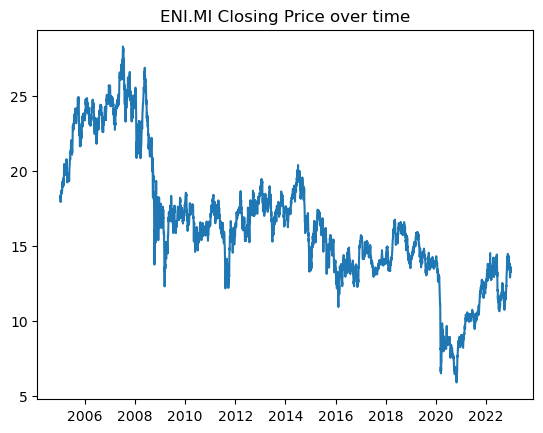

In [28]:
# Visualize data
plt.plot(df['Close'])
plt.title(f'{ticker} Closing Price over time');

In [32]:
# Descriptive statistics
df.describe()


,Open,High,Low,Close,Adj Close,Volume
count,4578.000000,4578.000000,4578.000000,4578.000000,4578.000000,4.578000e+03
mean,16.582417,16.738569,16.411691,16.575320,8.275776,1.948653e+07
std,4.369248,4.382661,4.348800,4.366311,1.484849,1.468957e+07
min,5.877000,6.013000,5.726000,5.885000,4.562848,0.000000e+00
25%,13.830000,13.950000,13.720000,13.820000,7.178139,1.143756e+07
50%,16.150000,16.296000,15.978000,16.131000,8.246522,1.565849e+07
75%,18.297500,18.430000,18.120001,18.267500,9.250033,2.187791e+07
max,28.389999,28.950001,28.139999,28.330000,12.755992,1.552161e+08


In [34]:
# Check for missing values
df.isnull().sum()


Open         0
High         0
Low          0
Close        0
Adj Close    0
Volume       0
dtype: int64

### 1.2 Features Engineering

In this small section, I would like to build a set of features or predictors based on historical stock price and volume data. In the context of Machine Learning classification algorithms, features or predictors are also known as an independent variable which are used to determine the value of the target variable.

#### Features Selection

In [38]:
def feature_selection(data, time_interval_list):
    # Calculate Statistical Indicators
    # Returns
    data['1D_L_Ret'] = np.log(data['Close'] / data['Close'].shift(1))
    # IntraDay Statistics, Open-Close and High-Low
    data['O-C'] = data['Close'] / data['Open'] - 1
    data['H-L'] = data['High'] / data['Low'] - 1
    
    # Technical Indicators
    # RSI
    period = 14
    delta = data['Close'].diff()
    gain = delta.where(delta > 0, 0)
    loss = -delta.where(delta < 0, 0)
    avg_gain = gain.rolling(window=period, min_periods=period).mean()
    avg_loss = loss.rolling(window=period, min_periods=period).mean()
    rs = avg_gain / avg_loss
    data['RSI'] = 100 - (100 / (1 + rs))
    
    # Bollinger Bands
    sma_period = 20
    SMA_b = data['Close'].rolling(window=sma_period).mean()
    STD_b = data['Close'].rolling(window=sma_period).std()
    data['Upper Band'] = SMA_b + STD_b * 2
    data['Lower Band'] = SMA_b - STD_b * 2


    # MACD
    short_ema = data['Close'].ewm(span=12, adjust=False).mean()
    long_ema = data['Close'].ewm(span=26, adjust=False).mean()
    data['MACD'] = short_ema - long_ema
    data['Signal Line'] = data['MACD'].ewm(span=9, adjust=False).mean()
 

    # Stochastic Oscillator
    data['L14'] = data['Low'].rolling(window=14).min()
    data['H14'] = data['High'].rolling(window=14).max()
    data['%K'] = 100 * ((data['Close'] - data['L14']) / (data['H14'] - data['L14']))
    data['%D'] = data['%K'].rolling(window=3).mean()


    # TSI
    long_period = 25
    short_period = 13
    data['M'] = data['Close'].diff(1)
    data['absolute_M'] = abs(data['M'])
    data['double_smoothed_M'] = data['M'].ewm(span=short_period, adjust=False).mean().ewm(span=long_period, adjust=False).mean()
    data['double_smoothed_absolute_M'] = data['absolute_M'].ewm(span=short_period, adjust=False).mean().ewm(span=long_period, adjust=False).mean()
    data['TSI'] = 100 * (data['double_smoothed_M'] / data['double_smoothed_absolute_M'])
    
    
    for i in time_periods:
        data[f'{i}D_Ret'] = data['Close'].pct_change(periods=i)
        data[f'{i}D_L_Ret'] = data['1D_L_Ret'].rolling(i).sum()
        data[f'Rol_{i}D_L_Std'] = data['1D_L_Ret'].rolling(window=i).std() * np.sqrt(i)
        data[f'Rol_{i}D_Std'] = data[f'{i}D_Ret'].rolling(window=i).std() * np.sqrt(i)
        data[f'{i}D_EWM_Std'] = data[f'{i}D_Ret'].ewm(span=i, adjust=False).std()
        
        if i > 1:
            # Rolling Simple Moving Average of Closing Price
            data[f'{i}D_SMA'] = data['Close'].rolling(window=i).mean()
            # Rolling Simple Moving Average of Lowest Daily Price
            data[f'{i}D_SMA_Low'] = data['Low'].rolling(window=i).mean()
            # Rolling Simple Moving Average of Highest Daily Price
            data[f'{i}D_SMA_High'] = data['High'].rolling(window=i).mean()
            # Rolling Simple Moving Average of Volume
            data[f'{i}D_SMA_Vol'] = data['Volume'].rolling(window=i).mean()
            # Exponential Moving Average of Closing Price
            data[f'{i}_EMA'] = data['Close'].ewm(span=i, adjust=False).mean()
            # Exponential Moving Average of Traded Volume
            data[f'{i}D_EWM_Vol']= data['Volume'].ewm(span=i, adjust=False).mean()
            # Rolling Statistics
            data[f'{i}D_Min_Low'] = data['Low'].rolling(window=i).min()
            data[f'{i}D_Max_Low'] = data['Low'].rolling(window=i).max()
            data[f'{i}D_Max_High'] = data['High'].rolling(window=i).max()
            data[f'{i}D_Min_High'] = data['High'].rolling(window=i).min()
            data[f'{i}D_Min_Open'] = data['Open'].rolling(window=i).min()
            data[f'{i}D_Max_Open'] = data['Open'].rolling(window=i).max()
            data[f'{i}D_Min_Close'] = data['Close'].rolling(window=i).min()
            data[f'{i}D_Max_Close'] = data['Close'].rolling(window=i).max()
            data[f'{i}D_Max_Low-{i}D_Min_High'] = data['Low'].rolling(window=i).max() - data['High'].rolling(window=i).min()
            data[f'{i}D_Max_Open-{i}D_Max_Close'] = data['Open'].rolling(window=i).max() - data['Close'].rolling(window=i).max()
            data[f'Rol_{i}D_Low'] = data['Low'].rolling(window=i).min()
            data[f'Rol_{i}D_High'] = data['High'].rolling(window=i).max()
            data[f'{i}D_Open_Chg'] = data['Open'].pct_change(periods=i)
            data[f'{i}D_High_Chg'] = data['High'].pct_change(periods=i)
            data[f'{i}D_Low_Chg'] = data['Low'].pct_change(periods=i)
            
            # Correlations
            data[f'{i}D_Corr_H_L'] = data['High'].rolling(window=i).corr(data['Low'])
            data[f'{i}D_Corr_Vol_Ret'] = data['1D_L_Ret'].rolling(window=i).corr(data['Volume'])
            data[f'{i}D_Corr_O_C'] = data['Open'].rolling(window=i).corr(data['Close'])
            data[f'{i}D_Corr_RSI_Ret'] = data['1D_L_Ret'].rolling(window=i).corr(data['RSI'])

        

    # Drop rows with any NaN values created by rolling operations
    data.dropna(inplace=True)

    return data
# Apply feature selection
time_periods = [5,7,10,14,18,20,24]
data = feature_selection(df, time_periods)

data


,Open,High,Low,Close,Adj Close,Volume,1D_L_Ret,O-C,H-L,RSI,...,24D_Max_Open-24D_Max_Close,Rol_24D_Low,Rol_24D_High,24D_Open_Chg,24D_High_Chg,24D_Low_Chg,24D_Corr_H_L,24D_Corr_Vol_Ret,24D_Corr_O_C,24D_Corr_RSI_Ret
Date,,,,,,,,,,,,,,,,,,,,,
2005-05-13,19.420000,19.549999,19.309999,19.549999,5.799212,24558352,-0.008658,0.006694,0.012429,47.878744,...,0.010000,19.049999,20.559999,-0.045231,-0.043542,-0.044532,0.961487,-0.262018,0.870042,0.034883
2005-05-16,19.680000,19.680000,19.260000,19.330000,5.733951,41998201,-0.011317,-0.017785,0.021807,40.659354,...,0.139999,19.049999,20.490000,-0.035767,-0.042802,-0.052165,0.941093,-0.304272,0.800703,0.015271
2005-05-17,19.400000,19.469999,19.330000,19.389999,5.751749,19588397,0.003099,-0.000515,0.007243,45.976983,...,-0.020000,19.049999,20.309999,-0.049951,-0.049780,-0.045432,0.903179,-0.320804,0.713977,0.051008
2005-05-18,19.469999,19.940001,19.469999,19.830000,5.882269,27127804,0.022439,0.018490,0.024140,61.083748,...,0.369999,19.049999,20.230000,-0.035183,-0.018218,-0.028928,0.835920,-0.266813,0.497698,0.175769
2005-05-19,19.809999,20.129999,19.760000,20.090000,5.959394,21058817,0.013026,0.014134,0.018725,63.425913,...,-0.190001,19.049999,20.129999,-0.020761,-0.004943,0.001521,0.852237,-0.307609,0.566095,0.314932
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-12-23,13.380000,13.532000,13.320000,13.476000,12.000820,5473355,0.007448,0.007175,0.015916,42.657920,...,-0.024000,12.792000,14.390000,-0.042096,-0.034119,-0.003442,0.977960,-0.219027,0.913230,0.402086
2022-12-27,13.598000,13.672000,13.528000,13.546000,12.063156,4121347,0.005181,-0.003824,0.010645,47.927447,...,-0.024000,12.792000,14.390000,-0.010335,-0.028563,-0.014712,0.975390,-0.346172,0.924332,0.289757
2022-12-28,13.574000,13.680000,13.428000,13.508000,12.029317,6186305,-0.002809,-0.004862,0.018767,51.675990,...,-0.024000,12.792000,14.390000,-0.040707,-0.048282,-0.043044,0.975075,-0.346346,0.920009,0.266090


#### Features Visualization

In this small section, I would like to visualize various features such as Volume, Intraday gaps, Relative Strength Indicator and more and draw their statistical distribution or their evolution over time. This will help us understand the relationship between the different variables and the closing price.

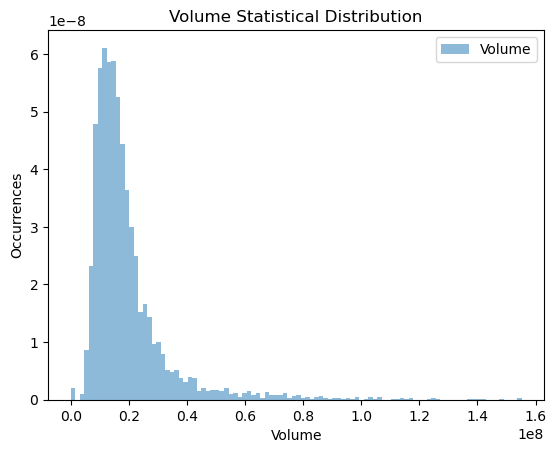

In [41]:
plt.hist(data['Volume'], bins=100, density=True, alpha=0.5, label='Volume')

plt.xlabel('Volume')
plt.ylabel('Occurrences')
plt.title('Volume Statistical Distribution')
plt.legend()
plt.grid(False)
plt.show()

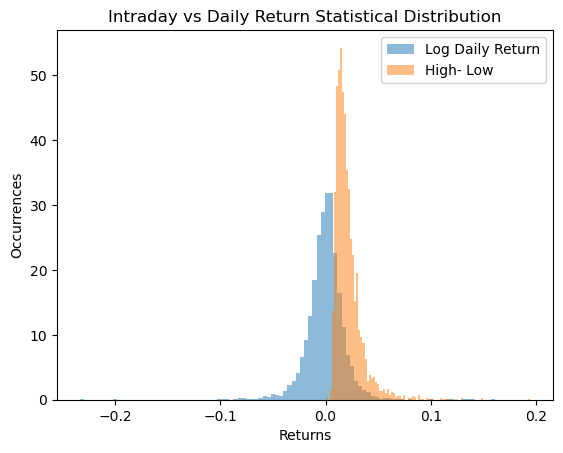

In [43]:
plt.hist(data['1D_L_Ret'], bins=100, density=True, alpha=0.5, label='Log Daily Return')
plt.hist(data['H-L'], bins=100, density=True, alpha=0.5, label='High- Low')

plt.xlabel('Returns')
plt.ylabel('Occurrences')
plt.title('Intraday vs Daily Return Statistical Distribution')
plt.legend()
plt.grid(False)
plt.show()

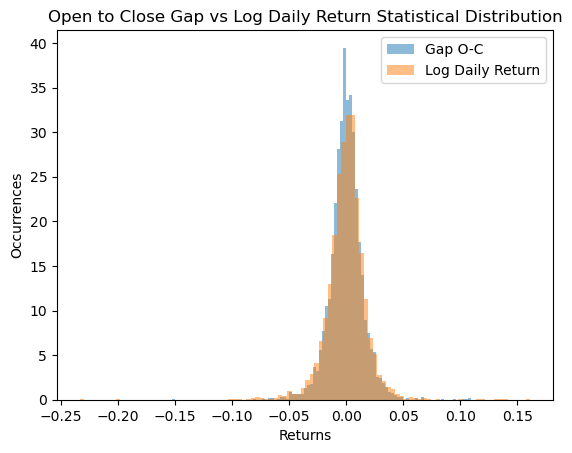

In [45]:
plt.hist(data['O-C'], bins=100, density=True, alpha=0.5, label='Gap O-C')
plt.hist(data['1D_L_Ret'], bins=100, density=True, alpha=0.5, label='Log Daily Return')

plt.xlabel('Returns')
plt.ylabel('Occurrences')
plt.title('Open to Close Gap vs Log Daily Return Statistical Distribution')
plt.legend()
plt.grid(False)
plt.show()

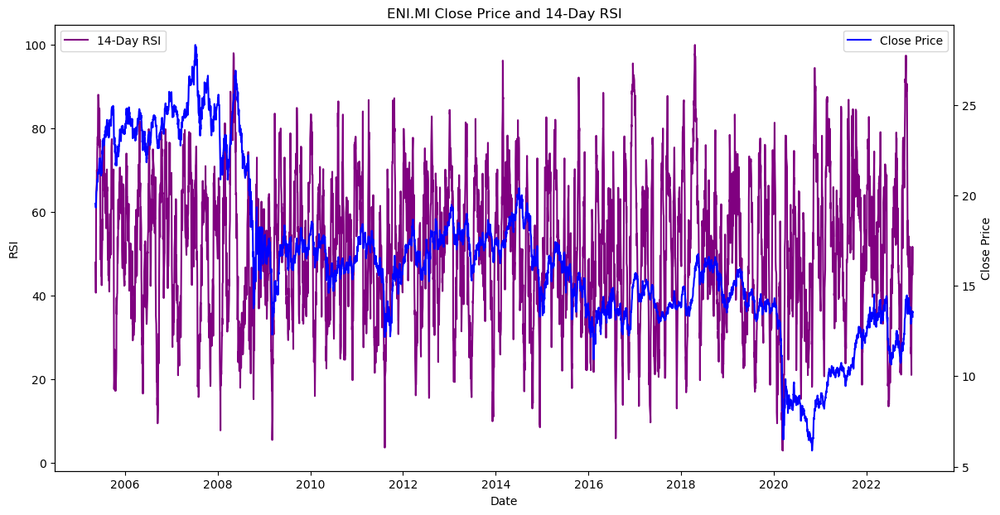

In [47]:
plt.figure(figsize=(14, 7))

# Plot RSI on the left y-axis
ax1 = plt.gca()
ax1.plot(data.index, data['RSI'], label='14-Day RSI', color='purple')
ax1.set_ylabel('RSI')
ax1.set_xlabel('Date')
ax1.set_title(f'{ticker} Close Price and 14-Day RSI')
ax1.legend(loc='upper left')

# Create a second y-axis to plot the Close price
ax2 = ax1.twinx()
ax2.plot(data.index, data['Close'], label='Close Price', color='blue')
ax2.set_ylabel('Close Price')
ax2.legend(loc='upper right')

plt.show()

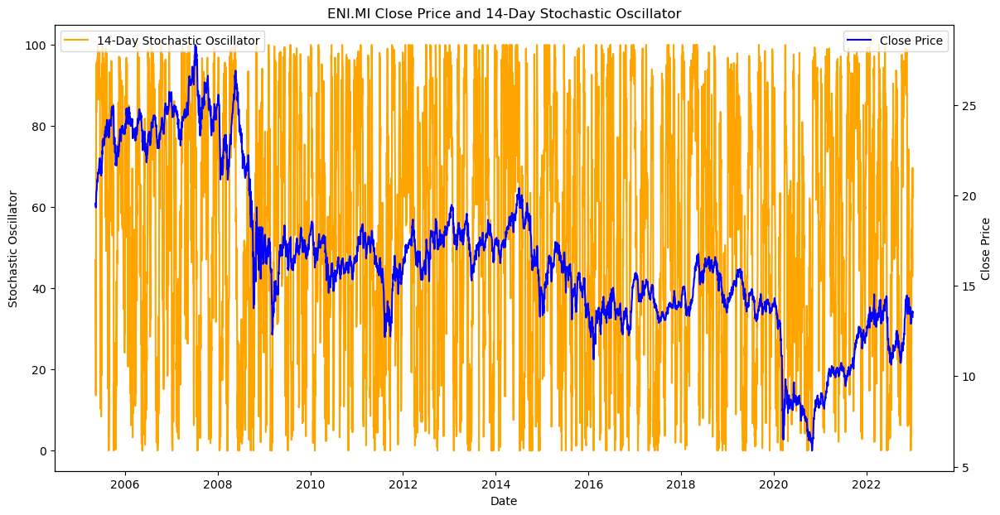

In [49]:
plt.figure(figsize=(14, 7))

# Plot RSI on the left y-axis
ax1 = plt.gca()
ax1.plot(data.index, data['%K'], label='14-Day Stochastic Oscillator', color='orange')
ax1.set_ylabel('Stochastic Oscillator')
ax1.set_xlabel('Date')
ax1.set_title(f'{ticker} Close Price and 14-Day Stochastic Oscillator')
ax1.legend(loc='upper left')

# Create a second y-axis to plot the Close price
ax2 = ax1.twinx()
ax2.plot(data.index, data['Close'], label='Close Price', color='blue')
ax2.set_ylabel('Close Price')
ax2.legend(loc='upper right')

plt.show()

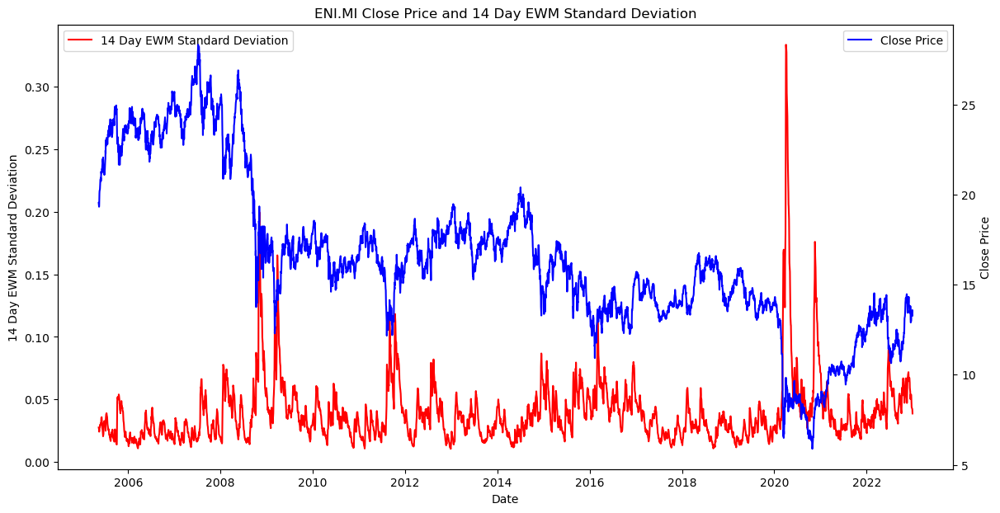

In [51]:
plt.figure(figsize=(14, 7))

# Plot RSI on the left y-axis
ax1 = plt.gca()
ax1.plot(data.index, data['14D_EWM_Std'], label='14 Day EWM Standard Deviation', color='red')
ax1.set_ylabel('14 Day EWM Standard Deviation')
ax1.set_xlabel('Date')
ax1.set_title(f'{ticker} Close Price and 14 Day EWM Standard Deviation')
ax1.legend(loc='upper left')

# Create a second y-axis to plot the Close price
ax2 = ax1.twinx()
ax2.plot(data.index, data['Close'], label='Close Price', color='blue')
ax2.set_ylabel('Close Price')
ax2.legend(loc='upper right')

plt.show()



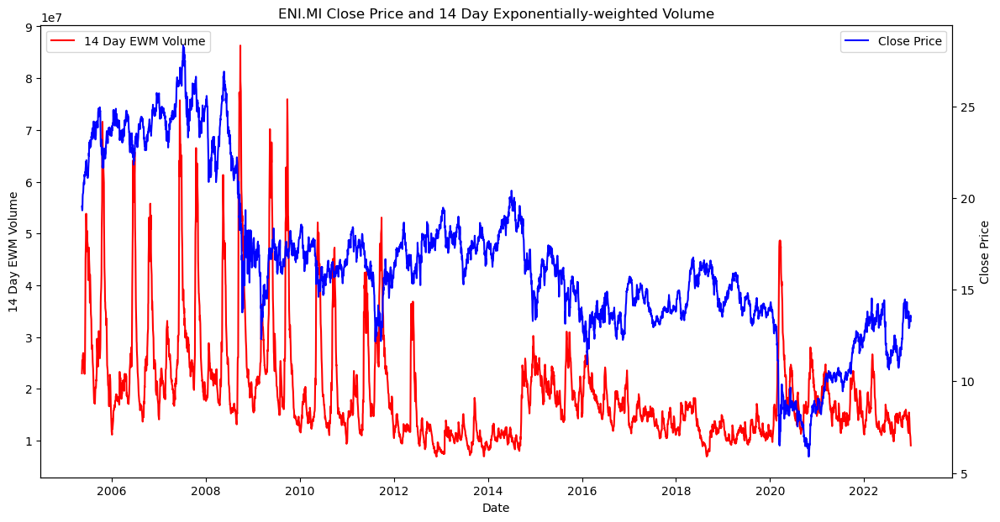

In [53]:
plt.figure(figsize=(14, 7))

# Plot RSI on the left y-axis
ax1 = plt.gca()
ax1.plot(data.index, data[f'14D_EWM_Vol'], label='14 Day EWM Volume', color='red')
ax1.set_ylabel('14 Day EWM Volume')
ax1.set_xlabel('Date')
ax1.set_title(f'{ticker} Close Price and 14 Day Exponentially-weighted Volume')
ax1.legend(loc='upper left')

# Create a second y-axis to plot the Close price
ax2 = ax1.twinx()
ax2.plot(data.index, data['Close'], label='Close Price', color='blue')
ax2.set_ylabel('Close Price')
ax2.legend(loc='upper right')

plt.show()



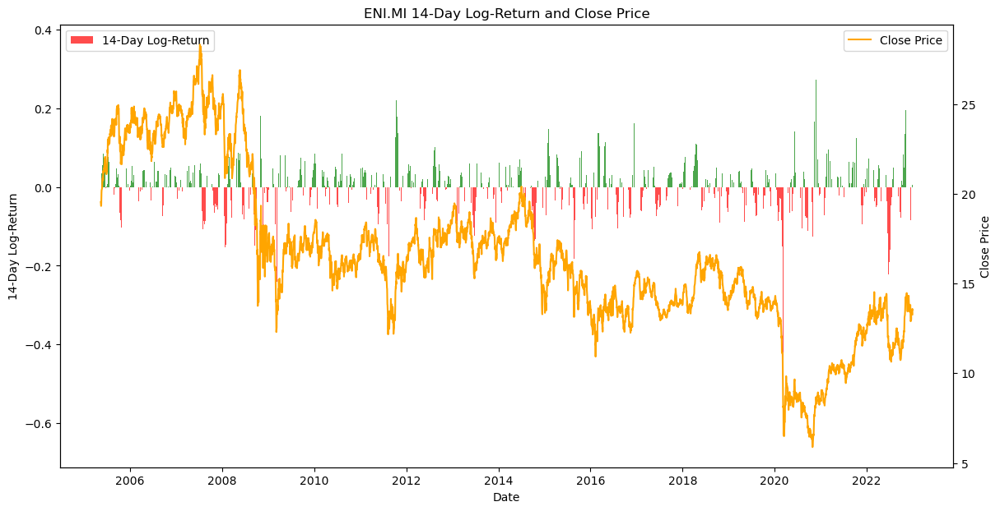

In [55]:
# Assuming 'features' is a DataFrame with columns '14-Day Log-Return' and 'Close'

fig, ax1 = plt.subplots(figsize=(14, 7))

returns = data['14D_L_Ret']

colors =['green' if val>0 else 'red' for val in returns]

# Plot '14-Day Log-Return' with vertical bars
ax1.bar(data.index, returns, color=colors, alpha=0.7, label='14-Day Log-Return')
ax1.set_xlabel('Date')
ax1.set_ylabel('14-Day Log-Return', color='black')
ax1.tick_params(axis='y', labelcolor='black')
ax1.legend(loc='upper left')

# Create a second y-axis to plot the 'Close' price
ax2 = ax1.twinx()
ax2.plot(data.index, data['Close'], color='orange', label='Close Price')
ax2.set_ylabel('Close Price', color='black')
ax2.tick_params(axis='y', labelcolor='black')
ax2.legend(loc='upper right')

plt.title(f'{ticker} 14-Day Log-Return and Close Price')
plt.show()

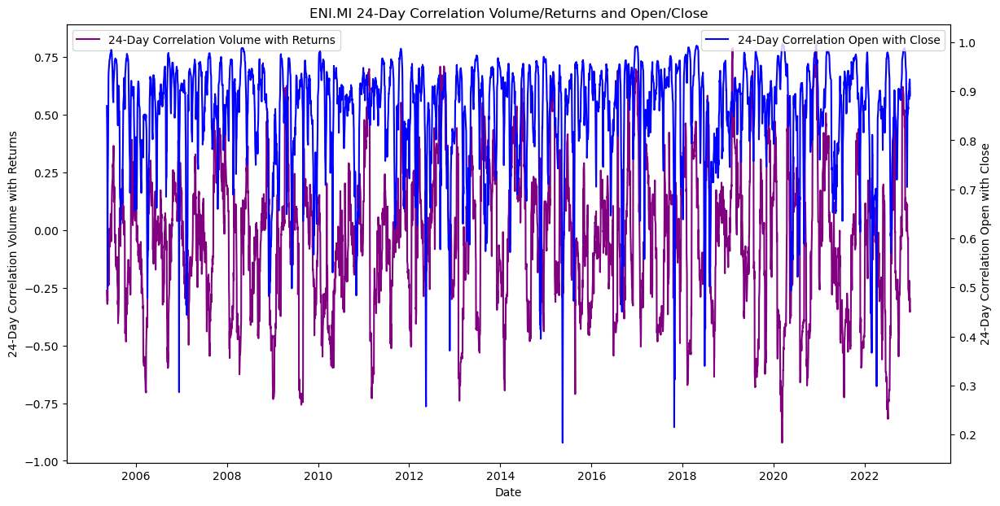

In [56]:
plt.figure(figsize=(14, 7))

# Plot RSI on the left y-axis
ax1 = plt.gca()
ax1.plot(data.index, data['24D_Corr_Vol_Ret'], label='24-Day Correlation Volume with Returns', color='purple')
ax1.set_ylabel('24-Day Correlation Volume with Returns')
ax1.set_xlabel('Date')
ax1.set_title(f'{ticker} 24-Day Correlation Volume/Returns and Open/Close')
ax1.legend(loc='upper left')

# Create a second y-axis to plot the Close price
ax2 = ax1.twinx()
ax2.plot(data.index, data['24D_Corr_O_C'], label='24-Day Correlation Open with Close', color='blue')
ax2.set_ylabel('24-Day Correlation Open with Close')
ax2.legend(loc='upper right')

plt.show()

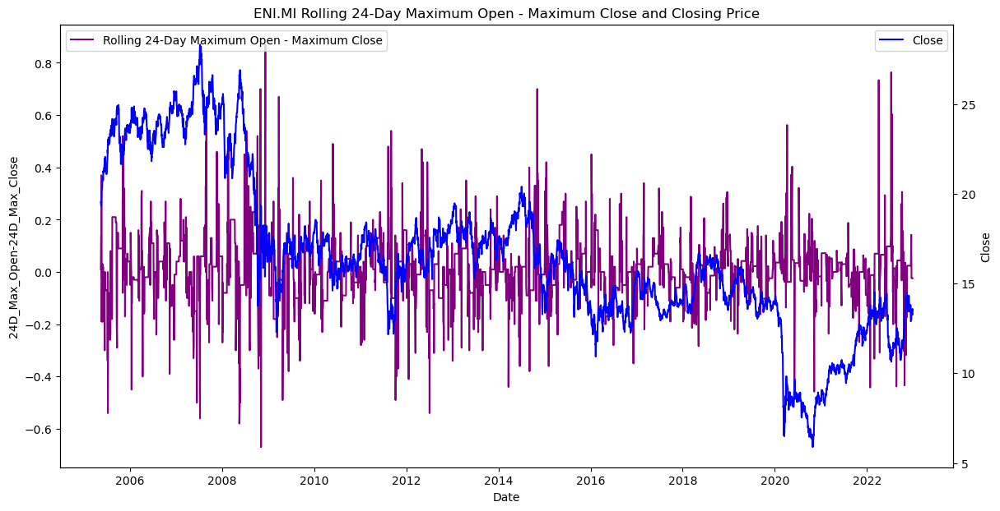

In [57]:
plt.figure(figsize=(14, 7))

# Plot RSI on the left y-axis
ax1 = plt.gca()
ax1.plot(data.index, data['24D_Max_Open-24D_Max_Close'], label='Rolling 24-Day Maximum Open - Maximum Close', color='purple')
ax1.set_ylabel('24D_Max_Open-24D_Max_Close')
ax1.set_xlabel('Date')
ax1.set_title(f'{ticker} Rolling 24-Day Maximum Open - Maximum Close and Closing Price')
ax1.legend(loc='upper left')

# Create a second y-axis to plot the Close price
ax2 = ax1.twinx()
ax2.plot(data.index, data['Close'], label='Close', color='blue')
ax2.set_ylabel('Close')
ax2.legend(loc='upper right')

plt.show()

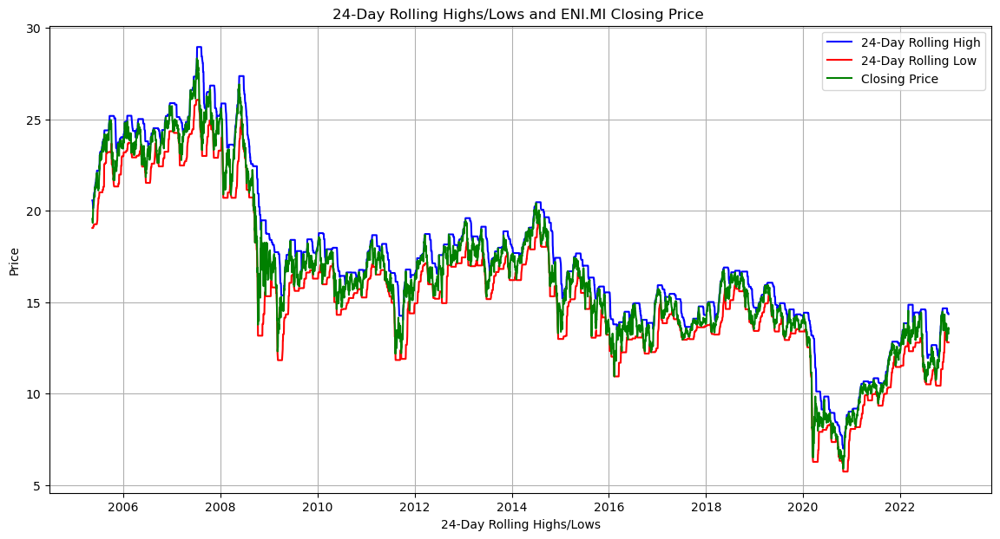

In [58]:
plt.figure(figsize=(14, 7))

plt.plot(data.index, data['Rol_24D_High'], label='24-Day Rolling High', color='blue')
plt.plot(data.index, data['Rol_24D_Low'], label='24-Day Rolling Low', color='red')
plt.plot(data.index,data['Close'], label='Closing Price', color = 'green')
plt.xlabel('24-Day Rolling Highs/Lows')
plt.ylabel('Price')
plt.title(f'24-Day Rolling Highs/Lows and {ticker} Closing Price ')
plt.legend()
plt.grid(True)
plt.show()



### 1.3  Further Feature Engineering: Correlation & Scaling

#### Correlation Analysis

In this small section, I would like to investigate the correlation underpinning the various features with the stock closing price and I would like to find very low-correlated features (i.e. their intra-correlation is low). We will set a correlation threshold of , so any features that has a correlation factor greater than the set threshold will be disregarded.



In [61]:
data.columns

Index(['Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume', '1D_L_Ret',
       'O-C', 'H-L', 'RSI',
       ...
       '24D_Max_Open-24D_Max_Close', 'Rol_24D_Low', 'Rol_24D_High',
       '24D_Open_Chg', '24D_High_Chg', '24D_Low_Chg', '24D_Corr_H_L',
       '24D_Corr_Vol_Ret', '24D_Corr_O_C', '24D_Corr_RSI_Ret'],
      dtype='object', length=233)

In [62]:
#Finding the best correlation with the 'Adj Close' column 
data.corr()['Adj Close'].sort_values(ascending=False)

Adj Close            1.000000
Signal Line          0.274779
double_smoothed_M    0.267029
MACD                 0.264665
TSI                  0.257596
                       ...   
14D_EWM_Vol         -0.400248
24D_SMA_Vol         -0.409186
18D_EWM_Vol         -0.414820
20D_EWM_Vol         -0.421635
24D_EWM_Vol         -0.434453
Name: Adj Close, Length: 233, dtype: float64

In [63]:
data.describe()

,Open,High,Low,Close,Adj Close,Volume,1D_L_Ret,O-C,H-L,RSI,...,24D_Max_Open-24D_Max_Close,Rol_24D_Low,Rol_24D_High,24D_Open_Chg,24D_High_Chg,24D_Low_Chg,24D_Corr_H_L,24D_Corr_Vol_Ret,24D_Corr_O_C,24D_Corr_RSI_Ret
count,4484.000000,4484.000000,4484.000000,4484.000000,4484.000000,4.484000e+03,4484.000000,4484.000000,4484.000000,4484.000000,...,4484.000000,4484.000000,4484.000000,4484.000000,4484.000000,4484.000000,4484.000000,4484.000000,4484.000000,4484.000000
mean,16.523370,16.680374,16.351629,16.515929,8.328573,1.947218e+07,-0.000088,-0.000326,0.021144,51.296103,...,0.009614,15.536395,17.427075,0.001316,0.001084,0.001525,0.953260,-0.032355,0.858511,0.218856
std,4.394405,4.408530,4.373024,4.391220,1.454082,1.479272e+07,0.018020,0.014576,0.013331,16.944860,...,0.112466,4.295886,4.476287,0.079988,0.077099,0.082430,0.041315,0.305170,0.107707,0.141429
min,5.877000,6.013000,5.726000,5.885000,4.562848,0.000000e+00,-0.233851,-0.152590,0.000000,2.856710,...,-0.670000,5.726000,6.990000,-0.483703,-0.479093,-0.510402,0.542531,-0.921596,0.183371,-0.557463
25%,13.800000,13.915500,13.648500,13.784500,7.267935,1.136846e+07,-0.008356,-0.007827,0.012945,39.006339,...,-0.049999,13.010000,14.598000,-0.044001,-0.043023,-0.044557,0.942266,-0.245760,0.816677,0.128046
50%,16.059999,16.219999,15.909000,16.052000,8.281168,1.558839e+07,0.000591,-0.000285,0.017804,51.708354,...,0.010000,15.150000,16.780001,0.004291,0.003656,0.005185,0.965632,-0.021568,0.888983,0.220178
75%,18.062500,18.240000,17.892499,18.080000,9.282005,2.180627e+07,0.008785,0.007331,0.025296,63.703794,...,0.060001,17.049999,18.870001,0.046189,0.044146,0.047283,0.980191,0.159665,0.931460,0.310996
max,28.389999,28.950001,28.139999,28.330000,12.755992,1.552161e+08,0.161436,0.109640,0.194782,100.000000,...,0.869999,26.059999,28.950001,0.440191,0.416887,0.446560,0.998024,0.805498,0.996008,0.711852


In [64]:
# remove the first feature that is correlated with any other feature
def drop_highly_correlated_features(data, threshold=0.55):
    col_corr = set()
    corr_matrix = data.corr()
    for i in range(len(corr_matrix.columns)):
        for j in range(i):
            if abs(corr_matrix.iloc[i, j]) > threshold:
                colname = corr_matrix.columns[i]
                col_corr.add(colname)
    return col_corr

In [65]:
# total correlated features
drop_correlated_features = drop_highly_correlated_features(data)
# drop the highly correlated features
features = data.drop(drop_correlated_features, axis=1)


features


,Open,Adj Close,Volume,1D_L_Ret,H-L,RSI,double_smoothed_absolute_M,5D_Max_Low-5D_Min_High,5D_Max_Open-5D_Max_Close,5D_Corr_H_L,5D_Corr_Vol_Ret,5D_Corr_RSI_Ret,14D_Max_Open-14D_Max_Close
Date,,,,,,,,,,,,,
2005-05-13,19.420000,5.799212,24558352,-0.008658,0.012429,47.878744,0.145335,0.070002,0.180000,0.987927,0.225024,0.073953,0.039999
2005-05-16,19.680000,5.733951,41998201,-0.011317,0.021807,40.659354,0.145550,0.020000,0.050001,0.865255,-0.320711,0.576893,0.039999
2005-05-17,19.400000,5.751749,19588397,0.003099,0.007243,45.976983,0.144781,0.100000,-0.039999,0.775857,-0.511852,0.661283,0.039999
2005-05-18,19.469999,5.882269,27127804,0.022439,0.024140,61.083748,0.147416,0.100000,-0.150000,0.737073,-0.400770,0.919242,0.039999
2005-05-19,19.809999,5.959394,21058817,0.013026,0.018725,63.425913,0.150739,0.290001,-0.280001,0.883352,-0.475723,0.883499,-0.190001
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-12-23,13.380000,12.000820,5473355,0.007448,0.015916,42.657920,0.185665,0.151999,0.004000,0.906129,0.647116,0.202247,0.014000
2022-12-27,13.598000,12.063156,4121347,0.005181,0.010645,47.927447,0.183780,0.346000,0.052000,0.947441,0.567056,0.096280,-0.054000
2022-12-28,13.574000,12.029317,6186305,-0.002809,0.018767,51.675990,0.180686,0.024000,0.052000,0.874566,0.734451,-0.518974,-0.054000


In [66]:
# Drop volume
features = features.drop(['Open','Volume','RSI','Adj Close'], axis=1, errors='ignore')

features

,1D_L_Ret,H-L,double_smoothed_absolute_M,5D_Max_Low-5D_Min_High,5D_Max_Open-5D_Max_Close,5D_Corr_H_L,5D_Corr_Vol_Ret,5D_Corr_RSI_Ret,14D_Max_Open-14D_Max_Close
Date,,,,,,,,,
2005-05-13,-0.008658,0.012429,0.145335,0.070002,0.180000,0.987927,0.225024,0.073953,0.039999
2005-05-16,-0.011317,0.021807,0.145550,0.020000,0.050001,0.865255,-0.320711,0.576893,0.039999
2005-05-17,0.003099,0.007243,0.144781,0.100000,-0.039999,0.775857,-0.511852,0.661283,0.039999
2005-05-18,0.022439,0.024140,0.147416,0.100000,-0.150000,0.737073,-0.400770,0.919242,0.039999
2005-05-19,0.013026,0.018725,0.150739,0.290001,-0.280001,0.883352,-0.475723,0.883499,-0.190001
...,...,...,...,...,...,...,...,...,...
2022-12-23,0.007448,0.015916,0.185665,0.151999,0.004000,0.906129,0.647116,0.202247,0.014000
2022-12-27,0.005181,0.010645,0.183780,0.346000,0.052000,0.947441,0.567056,0.096280,-0.054000
2022-12-28,-0.002809,0.018767,0.180686,0.024000,0.052000,0.874566,0.734451,-0.518974,-0.054000


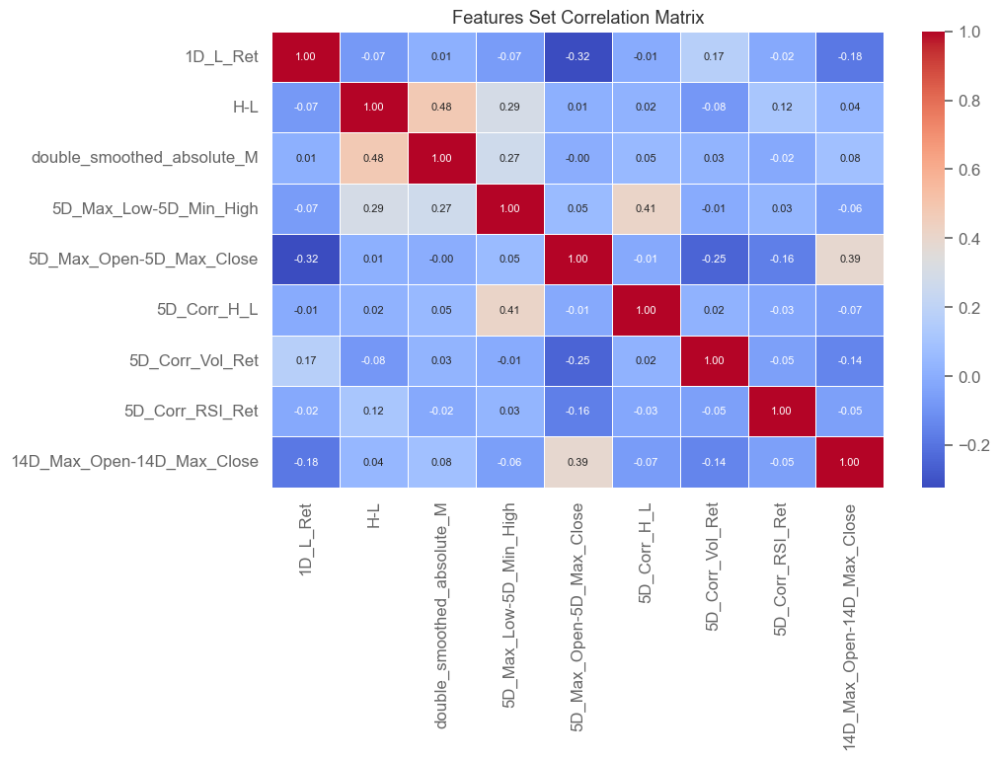

In [76]:
# remove features that are highly correlated
sns.heatmap(features.corr(),
annot=True,
annot_kws={"size": 8},
fmt=".2f",
linewidth=.5,
cmap="coolwarm",
cbar=True); #cmap="crest", virids, magma
plt.title('Features Set Correlation Matrix');



From the descriptive statistics and the correlation matrix, we can observe that the features that we are going to deploy into our Classification model.

We can observe that the log daily returns abide by the small-near zero assumption, only driven by standard deviation. This will have to be taken into consideration, when classifying positive or negative returns.

#### EDA for Feature Scaling

After finding the low-correlated features, we would like to ensure that those are scaled properly and do not show significant scaling divergeces. Having dropped the Volume column along with  , we have ensured that the comparison among the features is not affected by any scaling issue. In order to visualize each features range, we will plot the remaining features on a boxplot. 

In [78]:
features.describe()

,1D_L_Ret,H-L,double_smoothed_absolute_M,5D_Max_Low-5D_Min_High,5D_Max_Open-5D_Max_Close,5D_Corr_H_L,5D_Corr_Vol_Ret,5D_Corr_RSI_Ret,14D_Max_Open-14D_Max_Close
count,4484.000000,4484.000000,4484.000000,4484.000000,4484.000000,4484.000000,4484.000000,4484.000000,4484.000000
mean,-0.000088,0.021144,0.190970,0.164191,0.006187,0.818295,0.007065,0.336060,0.008415
std,0.018020,0.013331,0.085835,0.261765,0.150477,0.238470,0.554482,0.432815,0.126056
min,-0.233851,0.000000,0.056859,-0.440001,-1.700001,-0.831731,-0.996944,-0.980104,-1.150000
25%,-0.008356,0.012945,0.140181,-0.010000,-0.060000,0.782270,-0.477853,0.066343,-0.050000
50%,0.000591,0.017804,0.175647,0.106000,0.000000,0.902120,0.008493,0.422656,0.010000
75%,0.008785,0.025296,0.223300,0.270000,0.070001,0.959696,0.490099,0.673819,0.060001
max,0.161436,0.194782,0.734176,2.416000,1.090000,0.999835,0.998905,0.995064,1.020000


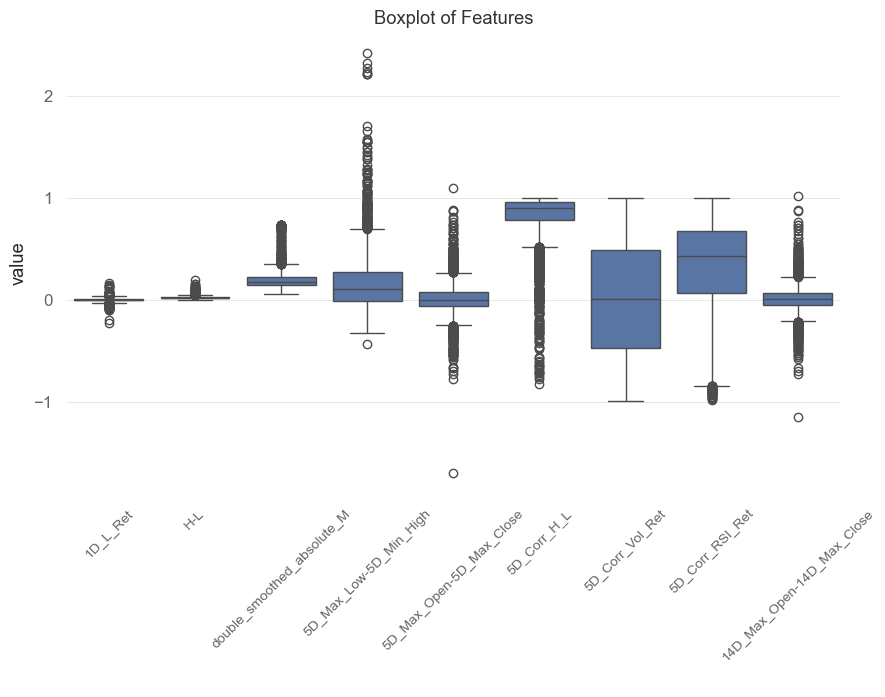

In [80]:
# study the distribution
# fig, ax = plt.subplots(figsize=(14,8))
sns.boxplot(x='variable', y='value', data=pd.melt(features))
plt.xlabel(' ')
#Rotate x-axis labels and adjust font size
plt.xticks(rotation=45, fontsize=10)  # Adjust rotation and fontsize as needed

plt.title('Boxplot of Features');


## 2. Support Vector Machine for Price Prediction

In this section, we are going to explore the Support Vector Machine universe and deploy it towards the attempt of predicting the chosen stock price, classifying the up-trends and the down-trends. Given our scope, I would like to start firstly with an introduction on classification problems and then enlighten about the underlying theory of SVM models, including Linear and Non-linear SVMs.

Moving on from the theory, we are going to develop a robust SVM model, starting from a baseline model and tuning the hyper-parameters in order to achieve a better accuracy metrics.


### 2.1 The Mathematical Machinery of SVMs

#### The Foundation of Classification

As I would like to build a classification model that predicts the up-movements for the selected stock, I will also provide a general overview of the classification within Machine Learning. Classification models predict a qualitative response and estimate a function based on a training observation data-set $(x_{1},y_{1}),.....,(x_{n},y_{n}) $

The training error is given as 

\begin{equation}
\frac{1}{n} \sum_{j=1}^{n} I(y_{i}\neq ŷ_{i})  
\end{equation}

where, 
- $ŷ_{i}$ is the predicated class label

- $I(y_{i}\neq ŷ_{i})$ is an indicator variable defined in the following manner; 

The test error rate is then given as

- $ \mathbb{E}(I(y_{i} \neq ŷ_{i}) $


#### A Quick Introduction on SVM Classification

Support vector machines (SVMs), also known as support vector networks, are supervised max-margin models used in machine learning for classification and regression tasks. These models, along with their learning algorithms, were developed at AT&T Bell Laboratories by Vladimir Vapnik and his colleagues (Boser et al., 1992; Guyon et al., 1993; Cortes and Vapnik, 1995; Vapnik et al., 1997). SVMs are heavily researched models rooted in the statistical learning theory of VC theory, introduced by Vapnik (1982, 1995) and Chervonenkis (1974).

SVMs are capable of performing both linear and non-linear classification. For non-linear classification, SVMs utilize the kernel trick, which allows them to map data into a higher-dimensional feature space using pairwise similarity comparisons between the original data points, thereby enabling more complex classification boundaries.

Classifying data is a foundational aspect of Machine Learning. If we are given some data points that belong to one of two classes, the goal is to decide which class a new data point will be in. Through Support Vector Machines, a data point is viewed as a ${\displaystyle p}$-dimensional vector and we would like to know whether we can separate such points with a ${\displaystyle (p-1)}$-dimensional hyperplane (linear classifier). Since there are many hyperplanes that might classify the data, one reasonable choice as the best hyperplane is the one that represents the largest separation, or margin, between the two classes. So we choose the hyperplane so that the distance from it to the nearest data point on each side is maximized. If such a hyperplane exists, it is known as the maximum-margin hyperplane.

A Support Vector Machine builds a hyperplane or set of hyperplanes in a high or infinite-dimensional space, which can be utilised for classification, regression, or other tasks. Intuitively, a good separation is achieved by the hyperplane that has the largest distance to the nearest training-data point of any class (so-called functional margin), since in general the larger the margin, the lower the generalization error of the classifier. A lower generalization error means that the implementer is less likely to experience overfitting.

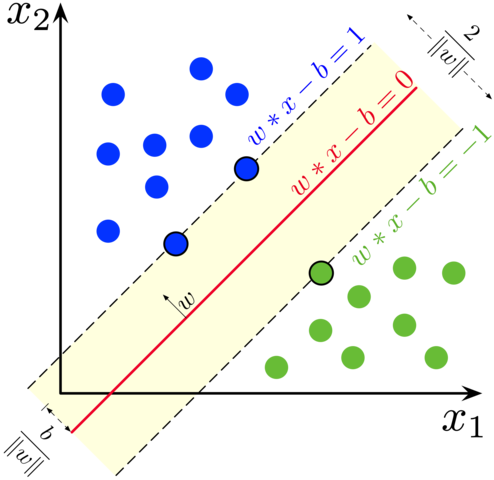

#### An overview of Linear and Non-Linear SVMs

We are given a training dataset of ${\displaystyle n}$ points of the form ${\displaystyle (\mathbf {x} _{1},y_{1}),\ldots ,(\mathbf {x} _{n},y_{n})}$ where the ${\displaystyle y_{i}}$ are either 1 or −1, each indicating the class to which the point
${\displaystyle \mathbf {x} _{i}}$ belongs. Each ${\displaystyle \mathbf {x} _{i}}$ is a ${\displaystyle p}$ -dimensional real vector. We want to find the "maximum-margin hyperplane" that divides the group of points ${\displaystyle \mathbf {x} _{i}}$ for which ${\displaystyle y_{i}=1}$ from the group of points for which ${\displaystyle y_{i}=-1}$, which is defined so that the distance between the hyperplane and the nearest point ${\displaystyle \mathbf {x} _{i}}$ from either group is maximized.
Any hyperplane can be written as the set of points ${\displaystyle \mathbf {x} }$ satisfying the below equation:

\begin{equation}
{\displaystyle \mathbf {w} ^{\mathsf {T}}\mathbf {x} -b=0}
\end{equation}

where ${\displaystyle \mathbf {w} }$  is the normal vector to the hyperplane.

Further to the linear fashion, this can be extended to non-linear settings, that were explored by 992, Bernhard Boser, Isabelle Guyon and Vladimir Vapnik, who suggested a method to create nonlinear classifiers by applying the kernel trick.

The non-linear techniques include but are not limited to:


- Polynomial (homogeneous): ${\displaystyle k(\mathbf {x} _{i},\mathbf {x} _{j})=(\mathbf {x} _{i}\cdot \mathbf {x} _{j})^{d}}$

- Polynomial (inhomogeneous): ${\displaystyle k(\mathbf {x} _{i},\mathbf {x} _{j})=(\mathbf {x} _{i}\cdot \mathbf {x} _{j}+r)^{d}}$

- Gaussian radial basis function: $ {\displaystyle k(\mathbf {x} _{i},\mathbf {x} _{j})=\exp \left(-\gamma \left\|\mathbf {x} _{i}-\mathbf {x} _{j}\right\|^{2}\right)}$

- Sigmoid: ${\displaystyle k(\mathbf {x} _{i},\mathbf {x} _{j})= tanh(\displaystyle \gamma \mathbf x_{i} \cdot \mathbf x_{j} + r)}$


In order to truly understand the foundations of non-linear technques applied to Support Vector Machine, I would like to glimpse over the "Kernel" trick and Mercer's condition.

#### Mercer Theorem

The Kernel trick, a fundamental technique in non-linear settings for Support Vector Machine and Data Lifting algorithms finds its origin in Mercer's Theorem, one of the greatest result in the field of Functional Analysis. Mercer's theorem describes a symmetric positive-definite function on a square as a sum of a convergent sequence of product functions.

To illustrate Mercer's theorem, let's start with a specific case before discussing the general form. Here, a kernel is a symmetric continuous function $K:[a,b]\times [a,b]\rightarrow \mathbb {R} $

where symmetric means that $ ∀ 𝑥,𝑦∈[𝑎,𝑏]:  K(x,y)=K(y,x)   $

A kernel K is defined as positive-definite if and only if
\begin{equation}
\sum _{i=1}^{n}\sum _{j=1}^{n}K(x_{i},x_{j})c_{i}c_{j}\geq 0
\end{equation}

for all finite sequences of points $x_1, ..., x_n$ of $[a, b]$ and all choices of real numbers $c_1, ..., c_n$. 

Associated to K is a linear operator (more specifically a Hilbert–Schmidt integral operator) on functions defined by the integral:

\begin{equation}
[T_{K}\varphi ](x)=\int _{a}^{b}K(x,s)\varphi (s)\,ds
\end{equation}

Below, I illustrated the so called "Kernel trick"

$k(\mathbf {x} ,\mathbf {x'} )=\langle \varphi (\mathbf {x} ),\varphi (\mathbf {x'} )\rangle _{\mathcal {V}}$



From this, the following Mercer's condition can be shown:

###### Mercer's Condition:

A symmetric function can be written as the inner product

\begin{equation}
K(x,y) = \langle \varphi (\mathbf {x} ),\varphi (\mathbf {y} )\rangle
\end{equation}

if and only if k is positive semidefinite i.e.

\begin{equation}
\iint g(x)K(x,y)g(y)\,dx\,dy\geq 0
\end{equation}

and g is square-integrable (i.e. $g ∈ L^2$, which means that
\begin{equation}
f:[a,b]\to \mathbb {C} {\text{ square integrable on }}[a,b]\quad \iff \quad \int _{a}^{b}|f(x)|^{2}\,\mathrm {d} x<\infty 
\end{equation}

In the attempt of utilising the SVM method, we will also perform Hyper-parameter tuning, with the goal of developing a more robust method and increase our accuracy in predicting the Up-Trend Class. We will perform Hyper-parameter tuning via Optuna and GridSearch CV.


### 2.2 Building the Logic for a Classification  Model

In this section, we are going to build our baseline SVM classification model, and specify our target variable logic and observe if there is any potential class imbalance. Then, in order to perform our analysis we are going to split the dataset into:

- Training

- Testing

Subsequently, we will use the SVM classifier from the scikit-learn package.

#### Baseline Model Set-up

In [91]:
# Specific X
X = features.values

In [93]:
# Specify y
y = np.where(df['Close'].shift(-1)>0.995*df['Close'],1,0)


In [95]:
#Check Class Imbalance
pd.Series(y).value_counts()


1    2983
0    1501
Name: count, dtype: int64

In [97]:
# Split the Data into Training and Testing
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2,shuffle=False)


In [99]:
svm_classifier = Pipeline([
            ("scaler", StandardScaler()),
            ("classifier", SVC(probability=True))
             ])

In [101]:
svm_classifier.fit(X_train, y_train)

Pipeline(steps=[('scaler', StandardScaler()),
                ('classifier', SVC(probability=True))])

In [102]:
y_pred = svm_classifier.predict(X_test)
print(y_pred)

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 

In [103]:
# Predict Probabilities
y_proba = svm_classifier.predict_proba(X_test)

print(y_proba)

[[0.32557899 0.67442101]
 [0.32621698 0.67378302]
 [0.32305797 0.67694203]
 ...
 [0.32856384 0.67143616]
 [0.32178237 0.67821763]
 [0.32140775 0.67859225]]


In [104]:
acc_train = accuracy_score(y_train, svm_classifier.predict(X_train))
acc_test = accuracy_score(y_test, svm_classifier.predict(X_test))
print(f'SVM Baseline Model -- Train Accuracy: {acc_train:0.4}, Test Accuracy: {acc_test:0.4}')

SVM Baseline Model -- Train Accuracy: 0.6794, Test Accuracy: 0.6522


#### Prediction Quality for the Untuned SVM Model

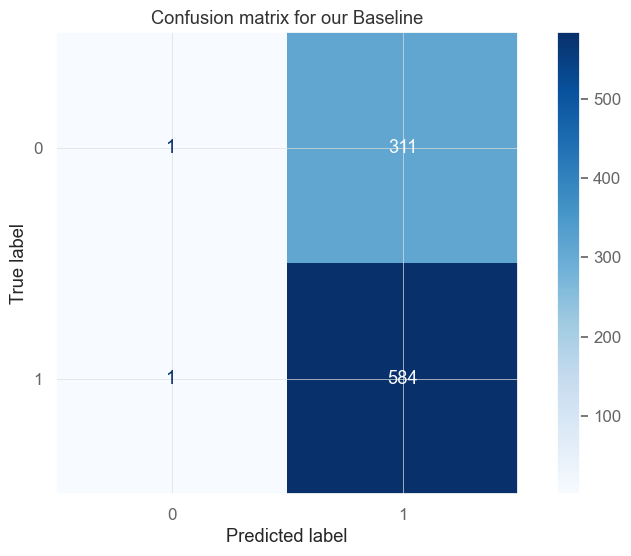

In [109]:
disp = ConfusionMatrixDisplay.from_estimator(svm_classifier, X_test, y_test, cmap=plt.cm.Blues)
        
plt.title('Confusion matrix for our Baseline')
plt.show()

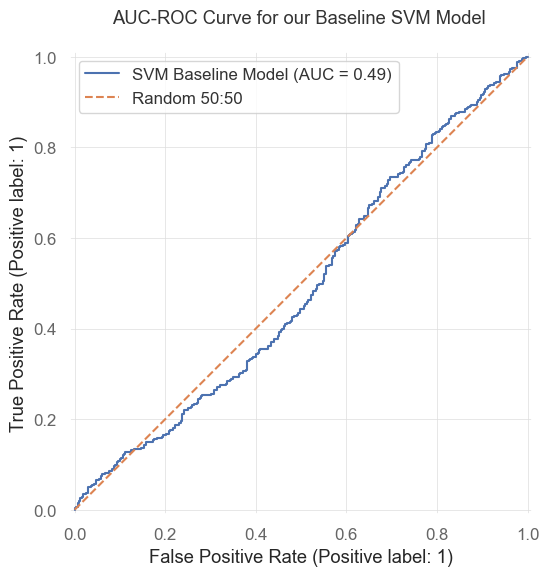

In [112]:
disp = RocCurveDisplay.from_estimator(svm_classifier,X_test,y_test,name='SVM Baseline Model')
        
plt.title("AUC-ROC Curve for our Baseline SVM Model \n")
plt.plot([0,1],[0,1],linestyle="--", label='Random 50:50')
plt.legend()
plt.show()

In [114]:
# Classification Report
print(classification_report(y_test, svm_classifier.predict(X_test)))

              precision    recall  f1-score   support

           0       0.50      0.00      0.01       312
           1       0.65      1.00      0.79       585

    accuracy                           0.65       897
   macro avg       0.58      0.50      0.40       897
weighted avg       0.60      0.65      0.52       897



#### Results Commentary for the Un-Tuned Model:

From the prediction quality section, we can observe that the model presents a low ROC score (less than a random fair coin flip). It also achieves an unbalanced confusion matrix, it is well trained at predicting the true negative, while this is not the case for the true positive.



When optimizing the model via hyper-parameters tuning, we would like to increase the ROC score, as well as achieving a more balanced confusion matrix

From the classification report, the model classifies the Up-Trend with a precision of 0.65, which results to be in the end a significant result, that would like to improve through the tuned model. Also we would like to improve testing accuracy to avoid overfitting, as currently we have Train Accuracy: 0.6794, Test Accuracy: 0.6522

### 2.2 Hyper-Parameter Tuning with Optuna

In this section, we will attempt at tuning the hyper-parameters for the Support Vector Machine Classifier using Optuna. We will build our optimization, find the best hyper-parameters and then tune the model. We will show the final results of the model versus our baseline.

#### Optimization Set-Up

First, let us identify the hyper-paramters that we can accommodate into our optimization framework.

In [119]:
svm = SVC()

svm.get_params()

{'C': 1.0,
 'break_ties': False,
 'cache_size': 200,
 'class_weight': None,
 'coef0': 0.0,
 'decision_function_shape': 'ovr',
 'degree': 3,
 'gamma': 'scale',
 'kernel': 'rbf',
 'max_iter': -1,
 'probability': False,
 'random_state': None,
 'shrinking': True,
 'tol': 0.001,
 'verbose': False}

In [121]:
# Split the dataset into training and validation sets
X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.2, random_state=42)

In [123]:
# Define the objective function to be optimized
def objective(trial, x, y):
    # Define the hyperparameters to search
    gamma = trial.suggest_loguniform('gamma', 1e-4, 1e4)
    #C = trial.suggest_loguniform('C', 1e-4, 1e4)
    
    
    
    # Create the SVM classifier with the suggested hyperparameters
    clf = Pipeline([
        ("scaler", StandardScaler()),
        ("svm", SVC(gamma=gamma, probability=True))
    ])
    
    tscv = TimeSeriesSplit(n_splits=2, gap=1)  # Reduced number of splits
    log_losses = []
    
    for train_idx, test_idx in tscv.split(x):
        xtrain, xtest = x[train_idx], x[test_idx]
        ytrain, ytest = y[train_idx], y[test_idx]
        
        clf.fit(xtrain, ytrain)
        preds = clf.predict_proba(xtest)
        log_losses.append(log_loss(ytest, preds))
    
    # Minimize the function (the log loss) 
    return np.mean(log_losses)

In [125]:
# Create a TPESampler with a fixed random seed
sampler = optuna.samplers.TPESampler(seed=105)

In [127]:
# Create a Study
study = optuna.create_study(
    study_name='tuning_svm',
    direction='minimize', sampler=sampler
)

[I 2024-10-06 21:04:12,983] A new study created in memory with name: tuning_svm


In [129]:
# Specify Optimization function
optimization_function = partial(objective, x=X, y=y)
study.optimize(optimization_function, n_trials=50,n_jobs=-1)

[I 2024-10-06 21:04:19,960] Trial 1 finished with value: 0.6438315164510675 and parameters: {'gamma': 0.004297937576381217}. Best is trial 1 with value: 0.6438315164510675.
[I 2024-10-06 21:04:20,446] Trial 6 finished with value: 0.6439126726764735 and parameters: {'gamma': 0.10160978880415672}. Best is trial 1 with value: 0.6438315164510675.
[I 2024-10-06 21:04:20,517] Trial 3 finished with value: 0.6436461514560194 and parameters: {'gamma': 0.24350414108389679}. Best is trial 3 with value: 0.6436461514560194.
[I 2024-10-06 21:04:20,528] Trial 2 finished with value: 0.6436985615871051 and parameters: {'gamma': 0.30336865746087066}. Best is trial 3 with value: 0.6436461514560194.
[I 2024-10-06 21:04:20,544] Trial 0 finished with value: 0.6441791493364746 and parameters: {'gamma': 0.05902516068720405}. Best is trial 3 with value: 0.6436461514560194.
[I 2024-10-06 21:04:22,624] Trial 7 finished with value: 0.6437869517187144 and parameters: {'gamma': 6.864408407695532}. Best is trial 3 w

In [134]:
# Print the best hyperparameters and the corresponding accuracy
best_params = study.best_params
best_accuracy = study.best_value
print('Best Hyperparameters:', best_params)
print('Best Accuracy:', best_accuracy)

Best Hyperparameters: {'gamma': 0.5188942911549312}
Best Accuracy: 0.6432286228552985


#### Optuna Charts

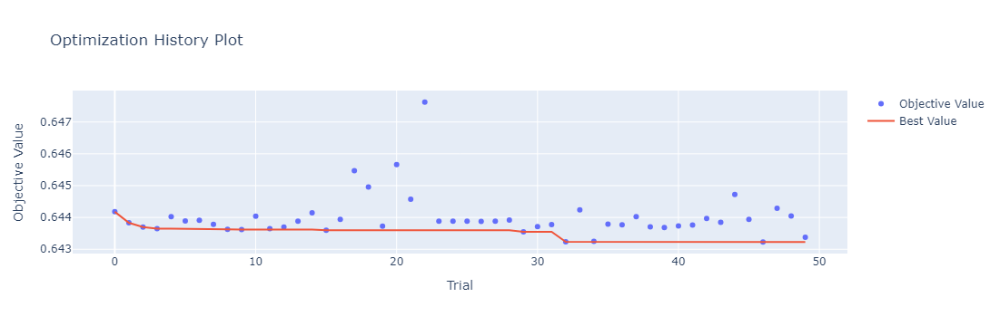

In [137]:
# plot Optimization History
optuna.visualization.plot_optimization_history(study)


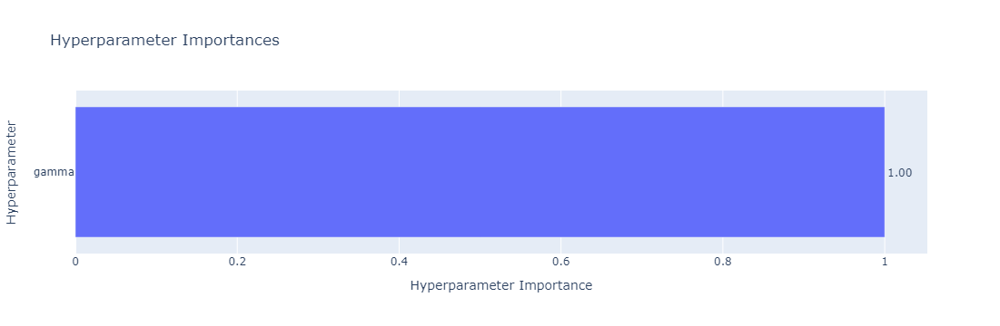

In [138]:
# Plot Param Importances
optuna.visualization.plot_param_importances(study)

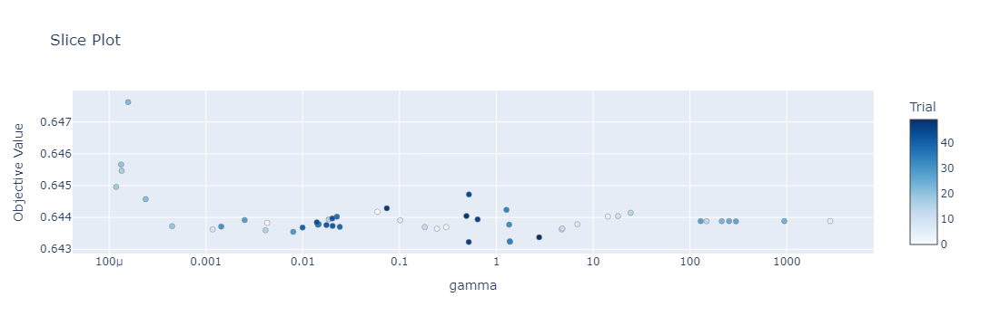

In [141]:
# plot accuracies for each HP trail
optuna.visualization.plot_slice(study)


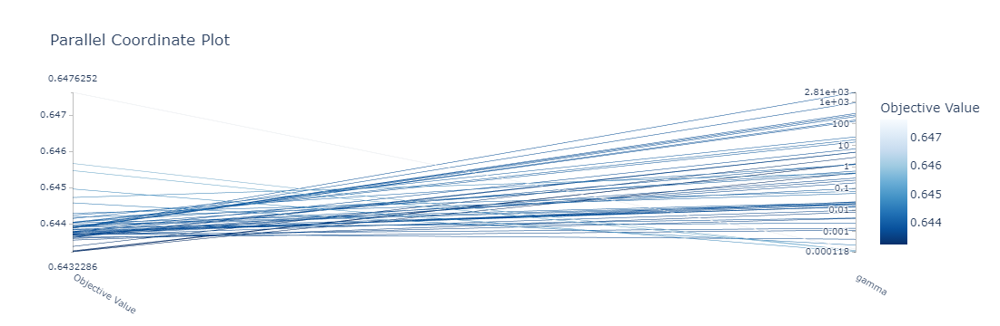

In [143]:
# plot parallel coordinates
optuna.visualization.plot_parallel_coordinate(study)

#### The Optuna-Tuned SVM Model

In [146]:
# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [148]:
# Train the final model with the best hyperparameters
optuna_svm = Pipeline([
    ("scaler", StandardScaler()),
    ("svm", SVC(gamma=best_params['gamma'],probability=True)) #=best_params['C']
])

In [150]:
# Fit the model
optuna_svm.fit(X_train, y_train)

Pipeline(steps=[('scaler', StandardScaler()),
                ('svm', SVC(gamma=0.5188942911549312, probability=True))])

In [154]:
# Predict the labels and probabilities
y_pred = optuna_svm.predict(X_test)
y_pred_proba = optuna_svm.predict_proba(X_test)

In [155]:
# Evaluate the model's performance
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)

Accuracy: 0.6432552954292085


In [158]:
acc_train = accuracy_score(y_train, optuna_svm.predict(X_train))
acc_test = accuracy_score(y_test, optuna_svm.predict(X_test))
print(f'SVM Tuned Model with Optuna -- Train Accuracy: {acc_train:0.4}, Test Accuracy: {acc_test:0.4}')

SVM Tuned Model with Optuna -- Train Accuracy: 0.765, Test Accuracy: 0.6433


#### Prediction Quality

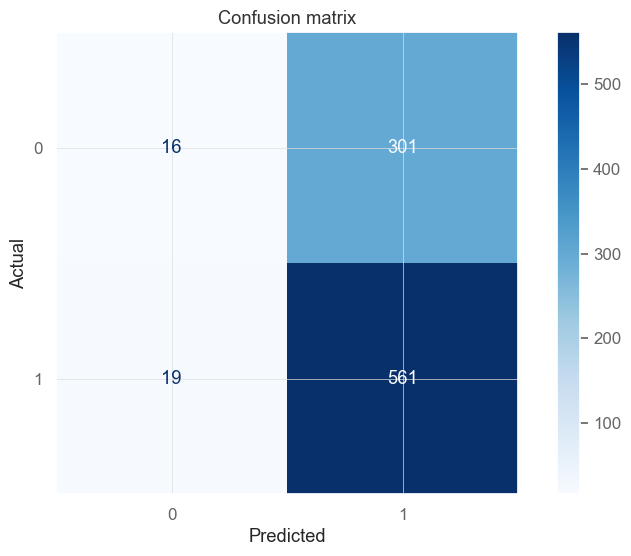

In [160]:
disp = ConfusionMatrixDisplay.from_estimator(optuna_svm, X_test, y_test, cmap=plt.cm.Blues)
plt.xlabel('Predicted')
plt.ylabel('Actual')        
plt.title('Confusion matrix')
plt.show()

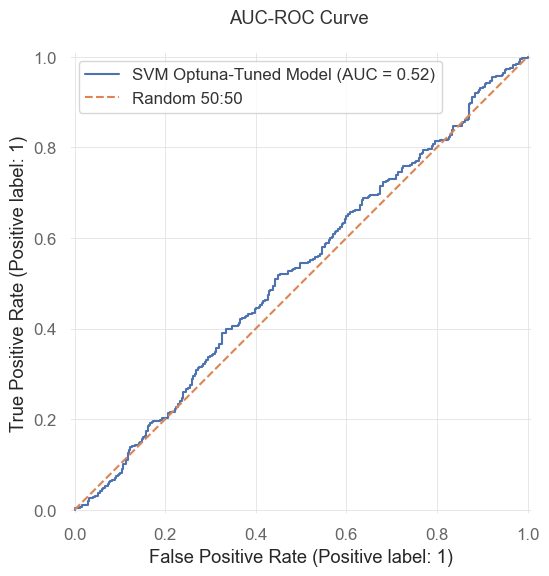

In [163]:
disp = RocCurveDisplay.from_estimator(optuna_svm,X_test,y_test,name='SVM Optuna-Tuned Model')
        
plt.title("AUC-ROC Curve \n")
plt.plot([0,1],[0,1],linestyle="--", label='Random 50:50')
plt.legend()
plt.show()

In [165]:
# Classification Report
print(classification_report(y_test, optuna_svm.predict(X_test)))

              precision    recall  f1-score   support

           0       0.46      0.05      0.09       317
           1       0.65      0.97      0.78       580

    accuracy                           0.64       897
   macro avg       0.55      0.51      0.43       897
weighted avg       0.58      0.64      0.54       897



#### Results Commentary for the Tuned Model

After a reasonable amount of trials (i.e. 50), we were able to identify the best gamma (we only choose to optimize one hyper-parameter given processing time constraint and also assessing the fact the the kernels were not appropriate for our use case).

The results are slightly positive, ROC score improved from 0.49 to 0.52, which is slightly higher than a random coin flip. Most importantly, the precision in determining class 1 (up trends) is 0.64. The confusion is also slightly less un-balanced. Train accuracy also increased to 0.765 and test accuracy to 0.6433


### 2.3 Hyper-Parameter Tuning with GridSearch CV

In this section, we will attempt at tuning the hyper-parameters for the Support Vector Machine Classifier using GridSearch CV. We will build our optimization, find the best hyper-parameters and then tune the model. We will show the final results of the model versus our baseline.

#### Optimization Set-Up

In [172]:
# Define parameter grid for GridSearchCV
param_grid = {
    'C': [0.1, 1, 10, 100, 1000],
    'gamma': [1, 0.1, 0.01, 0.001, 0.0001]
}

# Initializing the SVM model
svm = SVC(probability=True)

# Setting up GridSearchCV with 5-fold cross-validation and neg_log_loss scoring
grid_search = GridSearchCV(svm, param_grid, cv=5, scoring='neg_log_loss')
grid_search.fit(X_train, y_train)

# Retrieve the best hyperparameters and best score from grid_search
best_params = grid_search.best_params_
best_log_loss = grid_search.best_score_

# Printing the best parameters and log loss score
print("Best Parameters:", best_params)
print("Best Log Loss:", -best_log_loss)

Best Parameters: {'C': 1000, 'gamma': 0.0001}
Best Log Loss: 0.6339867334177527


In [173]:
# Printing the best parameters and log loss score
print("Best Parameters:", best_params)
print("Best Log Loss:", -best_log_loss)

Best Parameters: {'C': 1000, 'gamma': 0.0001}
Best Log Loss: 0.6339867334177527


#### The GridSearchCV-Tuned SVM Model

In [175]:
# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [176]:
# Train the final model with the best hyperparameters
grid_search_svm = Pipeline([
    ("scaler", StandardScaler()),
    ("svm", SVC(C=best_params['C'],gamma=best_params['gamma'],probability=True))
])

In [177]:
# Fit the model
grid_search_svm.fit(X_train, y_train)

Pipeline(steps=[('scaler', StandardScaler()),
                ('svm', SVC(C=1000, gamma=0.0001, probability=True))])

In [178]:
# Predict the labels and probabilities
y_pred = grid_search_svm.predict(X_test)
y_pred_proba = grid_search_svm.predict_proba(X_test)

print(y_pred)
print(y_pred_proba)

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 

In [179]:
# Evaluate the model's performance
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)

Accuracy: 0.6465997770345596


In [180]:
acc_train = accuracy_score(y_train, grid_search_svm.predict(X_train))
acc_test = accuracy_score(y_test, grid_search_svm.predict(X_test))
print(f'SVM Tuned Model with GridSearch CV -- Train Accuracy: {acc_train:0.4}, Test Accuracy: {acc_test:0.4}')

SVM Tuned Model with GridSearch CV -- Train Accuracy: 0.6699, Test Accuracy: 0.6466


#### Prediction Quality

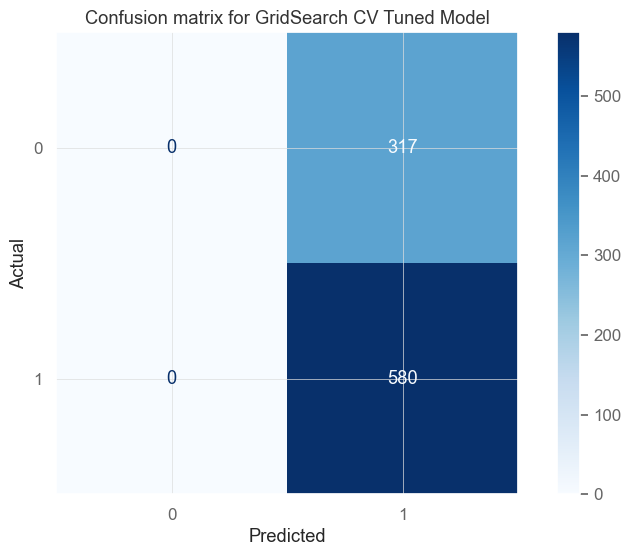

In [182]:
disp = ConfusionMatrixDisplay.from_estimator(grid_search_svm, X_test, y_test, cmap=plt.cm.Blues)
plt.xlabel('Predicted')
plt.ylabel('Actual')        
plt.title('Confusion matrix for GridSearch CV Tuned Model')
plt.show()

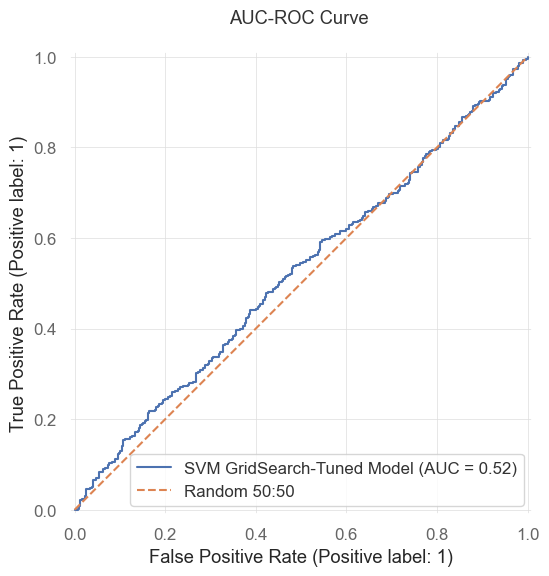

In [183]:
disp = RocCurveDisplay.from_estimator(grid_search_svm,X_test,y_test,name='SVM GridSearch-Tuned Model')
        
plt.title("AUC-ROC Curve \n")
plt.plot([0,1],[0,1],linestyle="--", label='Random 50:50')
plt.legend()
plt.show()

In [184]:
# Classification Report
print(classification_report(y_test, grid_search_svm.predict(X_test)))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00       317
           1       0.65      1.00      0.79       580

    accuracy                           0.65       897
   macro avg       0.32      0.50      0.39       897
weighted avg       0.42      0.65      0.51       897



#### Results Commentary for the Tuned Model

With choosing C and gamma to be optimized again given the same motivation towards a conservative optuna optimization, the results are again slightly positive and shows improvement from the baseline model.
An increased ROC score (from 0.49 to 0.52) and a precision standing at 0.65, as well as a slightly less un-balanced confusion matrix.

## 3. Logistic Classification for Price Prediction

In this section, we hope to build a price prediction model using Logistic Classification, in a similar fashion to our SVM section. We will glimpse over the theoretical foundation of the Logistic Universe, and then dive into the modelling part. 

### 3.1 The Theory behind the Logistic Universe:

Before diving into the Logistic Classification model, I would like to gloss over the Logistic Regression and its meaning in the statistical universe.

The logistic model (or logit model) is a statistical model that models the log-odds of an event as a linear combination of one or more independent variables. We seek to estimate the parameters of a logistic model (i.e.the coefficients in the linear combination). In this specific case, we are considering a binary logistic approach, where there is a single binary dependent variable, coded by an indicator variable, where the two values are labeled "1" or "0"  (Up or Down Trend).

#### Introduction on the Logistic Function

The logistic function was introduced in a series of three papers by Pierre François Verhulst between 1838 and 1847, who devised it as a model of population growth by adjusting the exponential growth model, under the guidance of Adolphe Quetelet. It has been widely used in different fields such as Biology, Demography, Economics, Geoscience, Mathematical Psychology, Probability, Statistics, and Machine Learning and more.

A logistic function or logistic curve is a common S-shaped curve (sigmoid curve) with the equation:
\begin{equation}
f(x)={\frac {L}{1+e^{-k(x-x_{0})}}}
\end{equation}

where 
- $x_{0}$ is value of the function's midpoint;

- ${\displaystyle L}$, the supremum of the values of the function;

- ${\displaystyle k}$, the logistic growth rate or steepness of the curve.


Commonly, set to be ${\displaystyle L=1,k=1,x_{0}=0}$,the standard form for a logistic function is:

\begin{equation}
f(x)={\frac {1}{1+e^{-x}}}={\frac {e^{x}}{e^{x}+1}}={\frac {1}{2}}+{\frac {1}{2}}\tanh \left({\frac {x}{2}}\right)
\end{equation}

which has a direct relationship with the hyperbolic tangent.


#### Properties of the Logistic Function:

The logistic function has the symmetry property that

${\displaystyle 1-f(x)=f(-x).}$

Hence, the below is an odd function:

${\displaystyle x\mapsto f(x)-1/2}$

Also, the logistic function is the inverse of the natural logit function

${\displaystyle \operatorname {logit} p=\log {\frac {p}{1-p}}{\text{ for }}0<p<1}$

#### Derivative of the Logistic Function:

The standard logistic function has the below derivative:

${\displaystyle {\begin{aligned}{\frac {\mathrm {d} }{\mathrm {d} x}}f(x)&={\frac {e^{x}\cdot (1+e^{x})-e^{x}\cdot e^{x}}{(1+e^{x})^{2}}}\\&={\frac {e^{x}}{(1+e^{x})^{2}}}\\&=\left({\frac {e^{x}}{1+e^{x}}}\right)\left({\frac {1}{1+e^{x}}}\right)\\&=\left({\frac {e^{x}}{1+e^{x}}}\right)\left(1-{\frac {e^{x}}{1+e^{x}}}\right)\\&=f(x)\left(1-f(x)\right)\end{aligned}}}$


#### Integral of the Logistic Function:

The integral of the standard logistic function can be computed via substitution (i.e. ${\displaystyle u=1+e^{x}}$):

${\displaystyle \int {\frac {e^{x}}{1+e^{x}}}\,dx=\int {\frac {1}{u}}\,du=\ln u=\ln(1+e^{x})}$



### 3.2 A general overview of Cost Functions

In the field of optimization, a cost function (sometimes also called loss function) is a function that maps an event or values of one or more variables onto a real number representing some "cost" associated with the event.

In Machine Learning, a cost function is utilised to represent the divergence from a mathematical model and the real data, and via varying the paramters within the model, you seek to minimize the cost function. This allows to find the most suitable model settings that fits the real data. 

There are different cost functions:

- Linear

- Quadratic 

- 0-1 loss function


In the context of Regressions, the following cost functions can be 

- Square or $L^2$ Loss

- Absolute or Laplace $L^1$ Loss

- Huber Loss


##### Square Loss

${\displaystyle \lambda (x)=C(t-x)^{2}\;}$


##### Absolute or Laplace Loss

The absolute loss function is given by:

${\displaystyle l(r) = |r| }$

It gives a median regression and it is more robust to outliers when compared to square loss.
 
 
##### Huber Loss

the Huber cost function is a loss function, that is less sensitive to outliers in data than the squared error loss, as it combines square and absolute losses, and it is quadratic for $|r| ≤ δ$ and linear for $|r| > δ$. It is also more robust and differentiable.


$\displaystyle L_{\delta }(a)={\begin{cases}{\frac {1}{2}}{a^{2}}&{\text{for }}|a|\leq \delta ,\\\delta \cdot \left(|a|-{\frac {1}{2}}\delta \right),&{\text{otherwise.}}\end{cases}}$

The Huber loss is the convolution of the absolute value function with the rectangular function, scaled and translated. Thus it "smoothens out" the former's corner at the origin.


In the context of Support Vector Machine:


##### Hinge Loss


${\displaystyle \ell (y)=\max(0,1-t\cdot y)}$



#### Cost Function for Linear Regression

In the case of a linear relationship between the x and y values, this could be thought of the simplest form:

\begin{equation}
y = \displaystyle \theta_{0} +\displaystyle \theta_{1}x  =: h_{\displaystyle \theta}(x)
\end{equation}

In this specific case, a quadratic cost function that represents the sum of the squares of the vertical distances between the data points and the fitting line:

\begin{equation}
\displaystyle J(\displaystyle \theta) = \frac{1}{2N} \sum_{n=1}^{N}[h_{\displaystyle \theta}(x)^{(n)} - y^{(n)}]^2
\end{equation}

This is the Ordinary Least Square Method

#### Cost Functions for Logistic Regression

In the context of Logistic Regression, we would like to fit a Sigmoidal function that we described above, and presents the simple form of:

\begin{equation}
h_{\displaystyle \theta}(x) = \frac{1}{1+ exp(-\displaystyle \theta_{0} -\displaystyle \theta_{1}x)}
\end{equation}

In this instance, the previously defined quadratic cost function is not suitable and therefore it needs to be adjusted 


\begin{equation}
\displaystyle J(\displaystyle \theta) = - \frac{1}{N} \sum_{n=1}^{N}y^{(n)}ln(h_{\displaystyle \theta}(x)^{(n)}) + (1-y^{(n)})ln(1-h_{\displaystyle \theta}(x)^{(n)})
\end{equation}

##### Logit Function


$ Logit = log(odds) = w_{0} + w_{1}x_{1} + w_{2}x_{2} +.....+ w_{q}x_{q} $

The odds of an event is defined as 
\begin{equation}
Odds = \frac{p}{1-p}
\end{equation}

The outcome happened with a probability:
\begin{equation}
p = \frac{Odds}{1+Odds}
\end{equation}


From the log-odds we can obtain the probability as:
\begin{equation}
log(\frac{p}{1-p}) = w_{0} + w_{1}x_{1} + w_{2}x_{2} +.....+ w_{q}x_{q} = z
\end{equation}

\begin{equation}
\frac{p}{1-p} = exp(z)
\end{equation}

\begin{equation}
p = \frac{1}{1+exp(-z)}
\end{equation}

#### The Binary Case

\begin{equation}
\hat{p}(X_i) = \operatorname{expit}(X_i w + w_0) = \frac{1}{1 + \exp(-X_i w - w_0)}
\end{equation}


As an optimization problem, binary class logistic regression with regularization term $r(w)$ minimizes the following cost function:

\begin{equation}
\min_{w} \frac{1}{S}\sum_{i=1}^n s_i
\left(-y_i \log(\hat{p}(X_i)) - (1 - y_i) \log(1 - \hat{p}(X_i))\right)
+ \frac{r(w)}{S C}\
\end{equation}


This can be done via the following penalties:

- $L^1$ Penalty:  $\|w\|_1$ 

- $L^2$ Penalty: $\|w\|^2_2 = \frac{1}{2}w^T w $

### 3.3 Building the Baseline Model

Firstly we are going to build our baseline model by splitting our dataset into Training and Testing, and then we are going to set as usual a Pipeline. We also want to verify the Binary Classes (0,1 - Down or Up movement) and output the predicted classes with their probabilities.

Within the logistic model, the probability is given by:


$\hat{y} = 
\begin{cases} 
0 & \text{if } \hat{p} < 0.5 \\
1 & \text{if } \hat{p} \geq 0.5 
\end{cases}$



#### Baseline Model Set-Up

In [79]:
# Split the Data into Training and Testing
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2,shuffle=False)


In [80]:
# Define a Baseline Model
unt_log_clf = Pipeline([
("scaler", StandardScaler()),
("classifier", LogisticRegression(class_weight='balanced'))
])
unt_log_clf.fit(X_train, y_train)

Pipeline(steps=[('scaler', StandardScaler()),
                ('classifier', LogisticRegression(class_weight='balanced'))])

In [81]:
# Verify Class Labels
unt_log_clf.classes_


array([0, 1])

In [82]:
# Predict the Class Labels
y_pred = unt_log_clf.predict(X_test)
y_pred[-20:]

array([1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1])

In [83]:
# Predict Probabilities
y_proba = unt_log_clf.predict_proba(X_test)
y_proba[-20:]

array([[0.4835058 , 0.5164942 ],
       [0.484401  , 0.515599  ],
       [0.48323462, 0.51676538],
       [0.48479212, 0.51520788],
       [0.524044  , 0.475956  ],
       [0.51240141, 0.48759859],
       [0.54925765, 0.45074235],
       [0.50779529, 0.49220471],
       [0.49033513, 0.50966487],
       [0.48230917, 0.51769083],
       [0.49106928, 0.50893072],
       [0.48616358, 0.51383642],
       [0.5181867 , 0.4818133 ],
       [0.56639855, 0.43360145],
       [0.49775796, 0.50224204],
       [0.50274505, 0.49725495],
       [0.50133149, 0.49866851],
       [0.5053515 , 0.4946485 ],
       [0.50669848, 0.49330152],
       [0.48110861, 0.51889139]])

In [84]:
# Get the Scores
acc_train = accuracy_score(y_train, unt_log_clf.fit(X_train, y_train).predict(X_train))
acc_test = accuracy_score(y_test, unt_log_clf.predict(X_test))
print(f'Baseline Model -- Train Accuracy: {acc_train:0.4}, Test Accuracy:{acc_test:0.4}')

Baseline Model -- Train Accuracy: 0.5753, Test Accuracy:0.5689


#### Prediction Quality 


As usual in this section, we are going to assess our Confusion Matrix, the AUC-ROC curve and the classification report to get a better understanding of how the model performs.

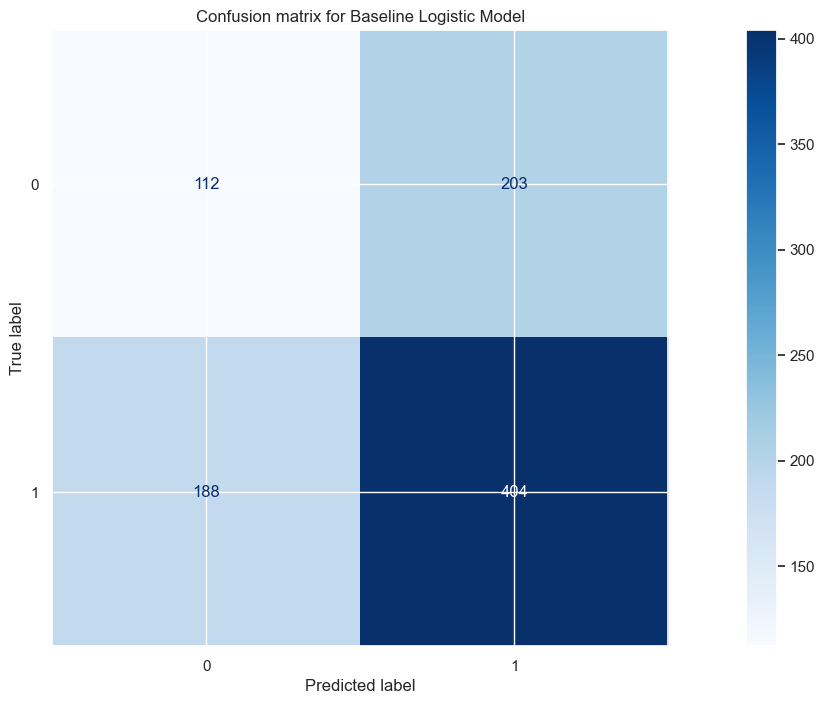

In [85]:
# Display confussion matrix
disp = ConfusionMatrixDisplay.from_estimator(
unt_log_clf,
X_test,
y_test,
# display_labels=model.classes_,
cmap=plt.cm.Blues
)
plt.title('Confusion matrix for Baseline Logistic Model')
plt.show()

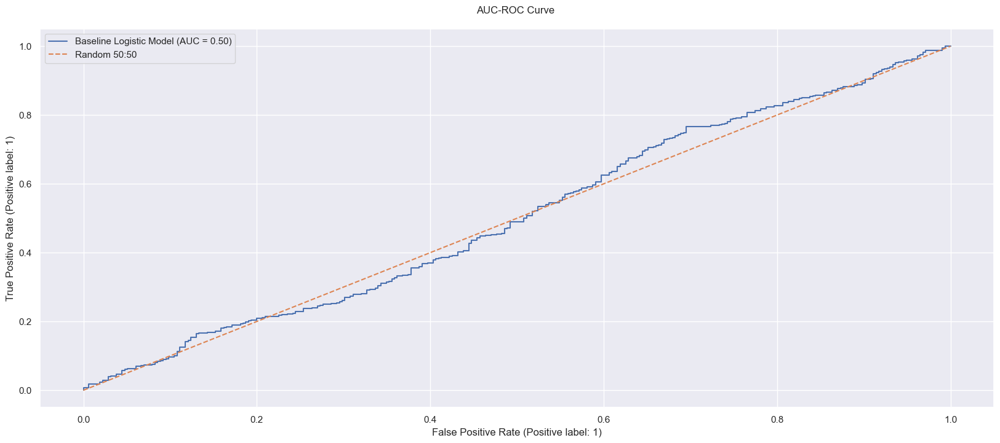

In [86]:
# Display ROCCurve
disp = RocCurveDisplay.from_estimator(
unt_log_clf,
X_test,
y_test,
name='Baseline Logistic Model')
plt.title("AUC-ROC Curve \n")
plt.plot([0,1],[0,1],linestyle="--", label='Random 50:50')
plt.legend()
plt.show()


In [87]:
# Classification Report
print(classification_report(y_test, unt_log_clf.predict(X_test)))

              precision    recall  f1-score   support

           0       0.37      0.36      0.36       315
           1       0.67      0.68      0.67       592

    accuracy                           0.57       907
   macro avg       0.52      0.52      0.52       907
weighted avg       0.56      0.57      0.57       907



In [88]:
# Get Params list
unt_log_clf.get_params()

{'memory': None,
 'steps': [('scaler', StandardScaler()),
  ('classifier', LogisticRegression(class_weight='balanced'))],
 'verbose': False,
 'scaler': StandardScaler(),
 'classifier': LogisticRegression(class_weight='balanced'),
 'scaler__copy': True,
 'scaler__with_mean': True,
 'scaler__with_std': True,
 'classifier__C': 1.0,
 'classifier__class_weight': 'balanced',
 'classifier__dual': False,
 'classifier__fit_intercept': True,
 'classifier__intercept_scaling': 1,
 'classifier__l1_ratio': None,
 'classifier__max_iter': 100,
 'classifier__multi_class': 'auto',
 'classifier__n_jobs': None,
 'classifier__penalty': 'l2',
 'classifier__random_state': None,
 'classifier__solver': 'lbfgs',
 'classifier__tol': 0.0001,
 'classifier__verbose': 0,
 'classifier__warm_start': False}

#### Results Commentary for the Un-Tuned Model

The baseline model shows a Train Accuracy of 0.5753 and a Test Accuracy of 0.5689, which is consistently lower than what achieved in SVM. Also, the confusion matrix shows a higher number of false positives/negatives.

### 3.4 Hyper-parameter Tuning with Optuna for the Logistic Model

In this section, we will attempt at tuning the hyper-parameters for the Logistic Model using Optuna. We will build our optimization, find the best hyper-parameters and then tune the model. We will show the final results of the model versus our baseline.

#### Optimization Set-Up

In [196]:
# Define Objective Function
def optimize(trial, x, y):
    # specify params range
    tolerance = trial.suggest_float("tol", 0.001, 0.01, log=True)
    regularization = trial.suggest_float('C', 0.001, 1, log=True)
    model = Pipeline([("scaler", StandardScaler()),("model", LogisticRegression(C=regularization,
tol=tolerance,
class_weight='balanced'))
])
    tscv = TimeSeriesSplit(n_splits=2, gap=1)
    ll = []
    for idx in tscv.split(x):
        train_idx, test_idx = idx[0], idx[1]
        xtrain = x[train_idx]
        ytrain = y[train_idx]
        xtest = x[test_idx]
        ytest = y[test_idx]
        model.fit(xtrain, ytrain)
        preds = model.predict(xtest)
        ll.append(log_loss(ytest, preds))
        # minimize the function (the log loss), you can also maximise the accuracy
    return -1.0 * np.mean(ll)


In [198]:
# Create a Study
study = optuna.create_study(
study_name='hp_lr',
direction='minimize'
)


[I 2024-10-06 21:25:11,794] A new study created in memory with name: hp_lr


In [200]:
# Specify Optimization function
optimization_function = partial(optimize, x=X, y=y)
study.optimize(optimization_function, n_trials=60)


[I 2024-10-06 21:25:12,452] Trial 0 finished with value: -14.60805363260404 and parameters: {'tol': 0.003276948476245132, 'C': 0.03791612542442372}. Best is trial 0 with value: -14.60805363260404.
[I 2024-10-06 21:25:12,469] Trial 1 finished with value: -14.66836764429935 and parameters: {'tol': 0.001533768877468093, 'C': 0.2786419332914942}. Best is trial 1 with value: -14.66836764429935.
[I 2024-10-06 21:25:12,485] Trial 2 finished with value: -14.258232364771242 and parameters: {'tol': 0.0071456404407373225, 'C': 0.002591415958132393}. Best is trial 1 with value: -14.66836764429935.
[I 2024-10-06 21:25:12,504] Trial 3 finished with value: -14.656304841960287 and parameters: {'tol': 0.009829479476848266, 'C': 0.012373995285955085}. Best is trial 1 with value: -14.66836764429935.
[I 2024-10-06 21:25:12,527] Trial 4 finished with value: -14.378860388161861 and parameters: {'tol': 0.006238660670458361, 'C': 0.1084122363575994}. Best is trial 1 with value: -14.66836764429935.
[I 2024-10-

In [201]:
# Get the Best Params
print(f'Best Params: {study.best_params}, Best Value: {study.best_value}')

Best Params: {'tol': 0.003067562791570186, 'C': 0.023105184680474265}, Best Value: -14.692493248977474


#### Optuna Charts

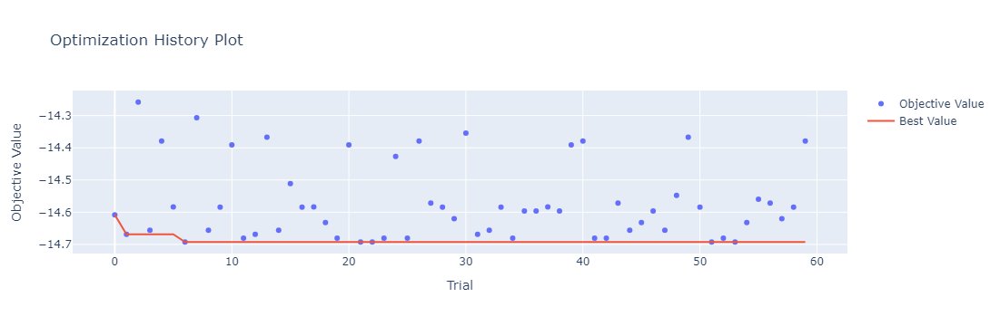

In [205]:
# plot Optimization History
optuna.visualization.plot_optimization_history(study)


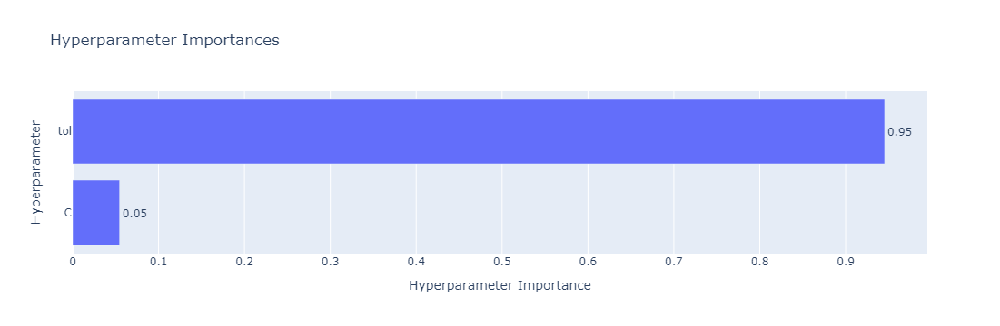

In [207]:
# Plot Param Importances
optuna.visualization.plot_param_importances(study)

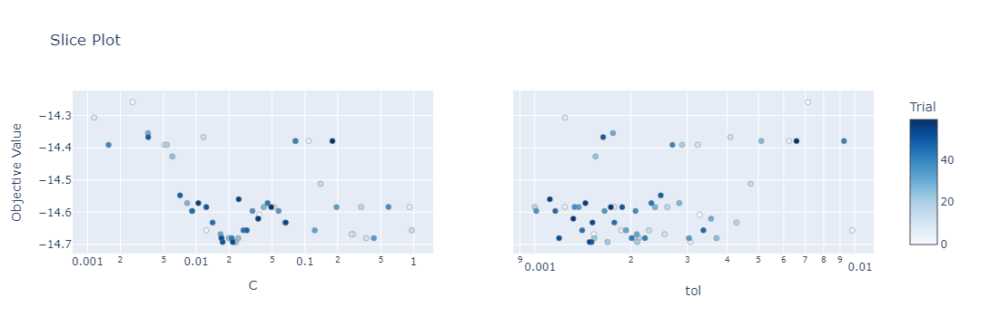

In [208]:
# plot accuracies for each HP trail
optuna.visualization.plot_slice(study)


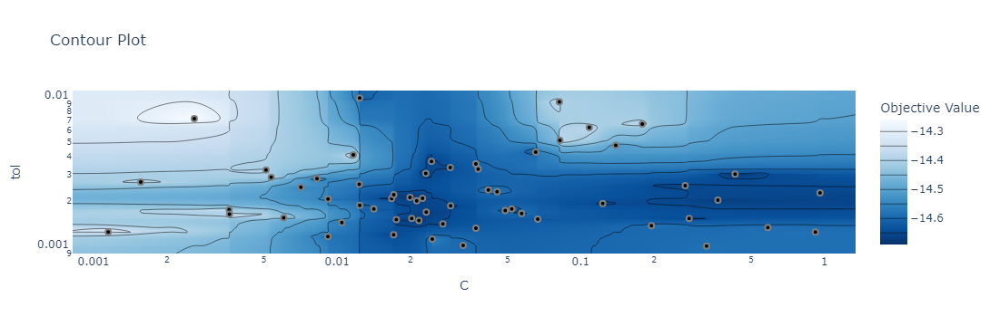

In [209]:
 # plot the surface
optuna.visualization.plot_contour(study, params=['tol', 'C'])

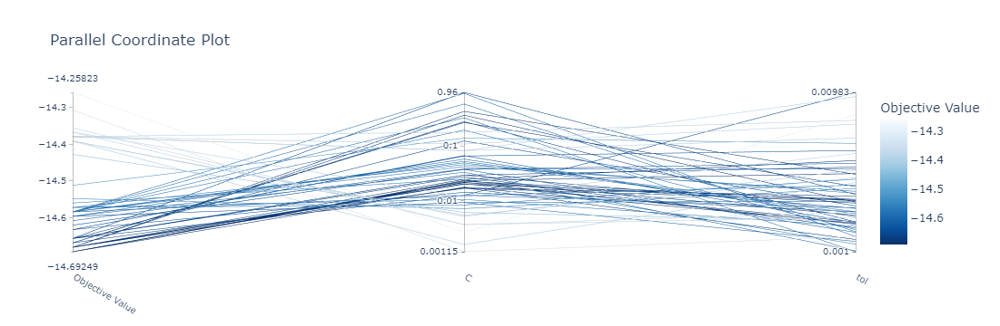

In [210]:
# plot parallel coordinates
optuna.visualization.plot_parallel_coordinate(study)

#### The Optuna-Tuned Logistic Model

In [214]:
# Scale and fit the model
optuna_tun_log_clf = Pipeline([
("scaler", StandardScaler()),
("classifier", LogisticRegression(
tol=study.best_params['tol'],
C=study.best_params['C'],
class_weight='balanced',
))
])
optuna_tun_log_clf.fit(X_train, y_train)

Pipeline(steps=[('scaler', StandardScaler()),
                ('classifier',
                 LogisticRegression(C=0.023105184680474265,
                                    class_weight='balanced',
                                    tol=0.003067562791570186))])

In [216]:
optuna_tun_log_clf.fit(X_train, y_train)

Pipeline(steps=[('scaler', StandardScaler()),
                ('classifier',
                 LogisticRegression(C=0.023105184680474265,
                                    class_weight='balanced',
                                    tol=0.003067562791570186))])

In [220]:
# Predict and evaluate
y_pred = optuna_tun_log_clf.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print('Accuracy on Test Set:', accuracy)

Accuracy on Test Set: 0.5707915273132664


In [222]:
y_proba = optuna_tun_log_clf.predict_proba(X_test)
log_loss_value = log_loss(y_test, y_proba)
print('Log Loss on Test Set:', log_loss_value)

Log Loss on Test Set: 0.6899014081542731


#### Prediction Quality

In [225]:
# Predict Class Labels
y_pred = optuna_tun_log_clf.predict(X_test)
# Predict Probabilities for upside
# y_proba = model.best_estimator_.predict_proba(X_test)[:,1]
# Measure Accuracy
acc_train = accuracy_score(y_train, optuna_tun_log_clf.predict(X_train))
acc_test = accuracy_score(y_test, y_pred)
# Print Accuracy
print(f'\n Training Accuracy \t: {acc_train :0.4} \n Test Accuracy \t\t:{acc_test :0.4}')


 Training Accuracy 	: 0.5693 
 Test Accuracy 		:0.5708


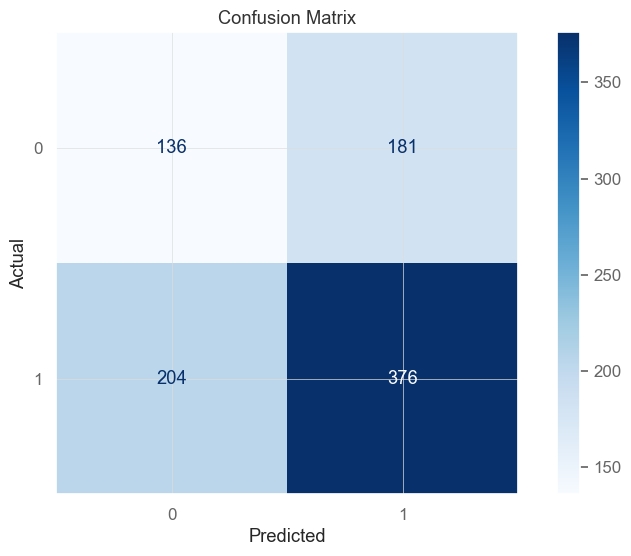

In [227]:
disp = ConfusionMatrixDisplay.from_estimator(optuna_tun_log_clf, X_test, y_test, cmap=plt.cm.Blues)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

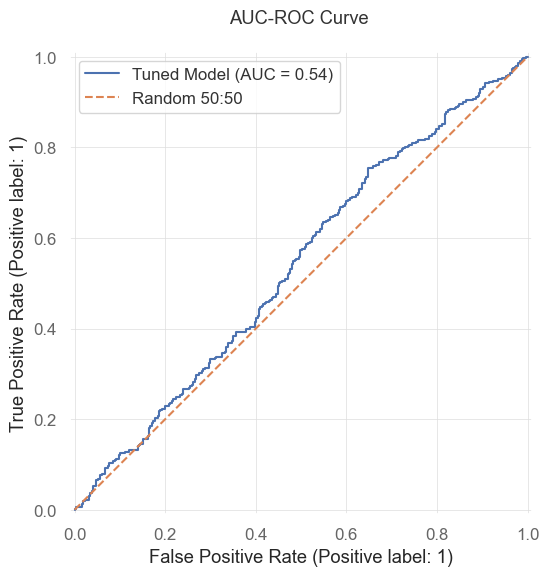

In [229]:
# Display ROCCurve
disp = RocCurveDisplay.from_estimator(
optuna_tun_log_clf,
X_test,
y_test,
name='Tuned Model')
plt.title("AUC-ROC Curve \n")
plt.plot([0,1],[0,1],linestyle="--", label='Random 50:50')
plt.legend()
plt.show()


In [231]:
# Classification Report
print(classification_report(y_test, y_pred))


              precision    recall  f1-score   support

           0       0.40      0.43      0.41       317
           1       0.68      0.65      0.66       580

    accuracy                           0.57       897
   macro avg       0.54      0.54      0.54       897
weighted avg       0.58      0.57      0.57       897



#### Results Commentary for the Tuned Model

When tuning the model with the Optuna library, the results are less impactful than for SVM. The confusion matrix is still quite un-balanced while precision remains in the high spectrum.

## 4. A Quick Detour on Voting Classifiers in Esemble Learning 

In this section, we are going to provide some background around the voting classifiers and their usage, starting from the foundation of esemble learning within the context of Machine Learning models.

### 4.1 Voting Classifiers Intro:

A voting classifier is a machine learning model that gains experience by training on a collection of several models and forecasts an output (class) based on the class with the highest likelihood of becoming the output. To forecast the output class based on the largest majority of votes, it takes the average of the results of each classifier provided into the voting classifier. The idea is to build a single model that learns from a set of models and predicts outputs according to their aggregate majority of votes for each output class, rather than building separate specialized models and identifying the accuracy for each of them.

Within the voting classifier spectrum, there are two types:

- Hard Voting

- Soft Voting


#### Hard vs Soft Voting:

In hard voting, the predicted output class is a class with the highest majority of votes, i.e., the class with the highest probability of being predicted by each classifier. The number of occurrences of votes for each class determines the final prediction, in that we will select the class with the highest number.

In the soft voting space, it is not the majority of votes that matters, as the final prediction is determined by the average of probabilities of the classes. We will choose instead the class with the highest average probability.

#### The Implementation Steps:

Upon loading the dataset, in order to implement the voting classifiers within the ensemble learning, we firstly require different classifiers to be created (e.g. Logistic Classifier, Random Forest Classifier, Gaussian Naive Bayes Classifier).

After performing the chosen classification models, a cross validation is performed to identify the accuracy of the models. 

When running the cross validation, the standard results will provide a mean accuracy with a standard deviation for each model used, and then we will either use the hard or soft voting methodology.

In the case of hard voting, our classifier will combine the predictions of individual classifiers using majority voting, while in the case of soft voting, it will combine the class probabilities of individual classifiers and selects the class with the highest probability.




## 5. Building Blocks for Support Vector Machine Trading Strategies

In this section, we will define some trading strategies based on the SVM. I will use the predicted signals for trades and compare the result of this strategy with the buy and hold and visualize the various performance and risk metrics of the built ML strategy via QuantStats.

The strategy will be long-only, hence we will not short the security at any point in time. We will build different strategies that will be based on the trading signals according to each different model (untuned one, optuna-tuned and grid-search tuned ones).

### 5.1 Un-Tuned Support Vector Machine Trading Strategy

#### Implementation

In [242]:
# Copy the dataframe for the trading strategy creation
svm_df = data.copy()

# Get Prediction
svm_df['Signal'] = svm_classifier.predict(X)
# Define Entry Logic -> Look at Previous Day Signal (if 1, the next trading day, positive returns are predicted) 
svm_df['Entry'] = np.where(svm_df['Signal'].shift(-1)==1, svm_df['Close'], 0)
# Defining Exit Logic
svm_df['Exit'] = np.where((svm_df['Entry'] != 0) & (svm_df['Open'].shift(-1) <=svm_df['Close']),
svm_df['Open'].shift(-1), 0)
svm_df['Exit'] = np.where((svm_df['Entry'] != 0) & (svm_df['Open'].shift(-1) >svm_df['Close']),
svm_df['Close'].shift(-1), svm_df['Exit'])

# Calculate MTM
svm_df['P&L'] = svm_df['Exit'] - svm_df['Entry']
# Generate Equity Curve
svm_df['Equity'] = svm_df['P&L'].cumsum() + svm_df['Close'][0]
# Calculate Benchmark Return
svm_df['Returns'] = np.log(svm_df['Close']).diff().fillna(0)
# Calculate Strategy Return
svm_df['Strategy'] = (svm_df['Equity']/svm_df['Equity'].shift(1) - 1).fillna(0)

svm_df



,Open,High,Low,Close,Adj Close,Volume,1D_L_Ret,O-C,H-L,RSI,...,24D_Corr_Vol_Ret,24D_Corr_O_C,24D_Corr_RSI_Ret,Signal,Entry,Exit,P&L,Equity,Returns,Strategy
Date,,,,,,,,,,,,,,,,,,,,,
2005-05-13,19.420000,19.549999,19.309999,19.549999,5.799212,24558352,-0.008658,0.006694,0.012429,47.878744,...,-0.262018,0.870042,0.034883,1,19.549999,19.330000,-0.219999,19.330000,0.000000,0.000000
2005-05-16,19.680000,19.680000,19.260000,19.330000,5.733951,41998201,-0.011317,-0.017785,0.021807,40.659354,...,-0.304272,0.800703,0.015271,1,19.330000,19.389999,0.059999,19.389999,-0.011317,0.003104
2005-05-17,19.400000,19.469999,19.330000,19.389999,5.751749,19588397,0.003099,-0.000515,0.007243,45.976983,...,-0.320804,0.713977,0.051008,1,19.389999,19.830000,0.440001,19.830000,0.003099,0.022692
2005-05-18,19.469999,19.940001,19.469999,19.830000,5.882269,27127804,0.022439,0.018490,0.024140,61.083748,...,-0.266813,0.497698,0.175769,1,19.830000,19.809999,-0.020000,19.809999,0.022439,-0.001009
2005-05-19,19.809999,20.129999,19.760000,20.090000,5.959394,21058817,0.013026,0.014134,0.018725,63.425913,...,-0.307609,0.566095,0.314932,1,20.090000,20.070000,-0.020000,19.789999,0.013026,-0.001010
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-12-23,13.380000,13.532000,13.320000,13.476000,12.000820,5473355,0.007448,0.007175,0.015916,42.657920,...,-0.219027,0.913230,0.402086,1,13.476000,13.546000,0.070000,33.899997,0.007448,0.002069
2022-12-27,13.598000,13.672000,13.528000,13.546000,12.063156,4121347,0.005181,-0.003824,0.010645,47.927447,...,-0.346172,0.924332,0.289757,1,13.546000,13.508000,-0.037999,33.861998,0.005181,-0.001121
2022-12-28,13.574000,13.680000,13.428000,13.508000,12.029317,6186305,-0.002809,-0.004862,0.018767,51.675990,...,-0.346346,0.920009,0.266090,1,13.508000,13.400000,-0.108001,33.753997,-0.002809,-0.003189


In [243]:
qs.reports.html(svm_df['Strategy'], svm_df['Returns'])

#### Back-Testing via QuantStats

### 5.2 Optuna-Tuned Support Vector Machine Trading Strategy

#### Implementation

In [108]:
# Copy the dataframe for the trading strategy creation
optuna_svm_df = data.copy()

# Get Prediction
optuna_svm_df['Signal'] = optuna_svm.predict(X)
# Define Entry Logic -> Look at Previous Day Signal (if 1, the next trading day, positive returns are predicted) 
optuna_svm_df['Entry'] = np.where(optuna_svm_df['Signal'].shift(-1)==1, optuna_svm_df['Close'], 0)
# Defining Exit Logic
optuna_svm_df['Exit'] = np.where((optuna_svm_df['Entry'] != 0) & (optuna_svm_df['Open'].shift(-1) <=optuna_svm_df['Close']),
optuna_svm_df['Open'].shift(-1), 0)
optuna_svm_df['Exit'] = np.where((optuna_svm_df['Entry'] != 0) & (optuna_svm_df['Open'].shift(-1) >optuna_svm_df['Close']),
optuna_svm_df['Close'].shift(-1), optuna_svm_df['Exit'])

# Calculate MTM
optuna_svm_df['P&L'] = optuna_svm_df['Exit'] - optuna_svm_df['Entry']
# Generate Equity Curve
optuna_svm_df['Equity'] = optuna_svm_df['P&L'].cumsum() + optuna_svm_df['Close'][0]
# Calculate Benchmark Return
optuna_svm_df['Returns'] = np.log(optuna_svm_df['Close']).diff().fillna(0)
# Calculate Strategy Return
optuna_svm_df['Strategy'] = (optuna_svm_df['Equity']/optuna_svm_df['Equity'].shift(1) - 1).fillna(0)

optuna_svm_df



,Open,High,Low,Close,Adj Close,Volume,1D_L_Ret,O-C,H-L,RSI,...,24D_Corr_Vol_Ret,24D_Corr_O_C,24D_Corr_RSI_Ret,Signal,Entry,Exit,P&L,Equity,Returns,Strategy
Date,,,,,,,,,,,,,,,,,,,,,
2005-03-09,20.320000,20.410000,20.110001,20.170000,6.089722,19213204,-0.006424,-0.007382,0.014918,66.804983,...,0.302396,0.943878,0.246797,0,20.170000,20.020000,-0.150000,20.020000,0.000000,0.000000
2005-03-10,20.020000,20.059999,19.740000,19.760000,5.965939,32589023,-0.020537,-0.012987,0.016211,54.511277,...,0.022096,0.947563,0.314818,1,19.760000,19.790001,0.030001,20.050001,-0.020537,0.001499
2005-03-11,19.820000,19.870001,19.719999,19.790001,5.974995,23869774,0.001517,-0.001514,0.007607,57.587580,...,0.030297,0.947668,0.285689,1,19.790001,19.770000,-0.020000,20.030001,0.001517,-0.000998
2005-03-14,19.770000,20.010000,19.770000,19.870001,5.999148,21297856,0.004034,0.005058,0.012140,64.462837,...,0.024320,0.949006,0.296445,1,0.000000,0.000000,0.000000,20.030001,0.004034,0.000000
2005-03-15,19.969999,20.049999,19.910000,19.990000,6.035378,21322031,0.006021,0.001002,0.007032,70.000000,...,0.050703,0.949741,0.302598,0,19.990000,19.910000,-0.080000,19.950001,0.006021,-0.003994
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-12-23,13.380000,13.532000,13.320000,13.476000,12.214632,5473355,0.007448,0.007175,0.015916,42.657920,...,-0.219027,0.913230,0.402086,1,13.476000,13.546000,0.070000,28.789016,0.007448,0.002437
2022-12-27,13.598000,13.672000,13.528000,13.546000,12.278079,4121347,0.005181,-0.003824,0.010645,47.927447,...,-0.346172,0.924332,0.289757,1,13.546000,13.508000,-0.037999,28.751017,0.005181,-0.001320
2022-12-28,13.574000,13.680000,13.428000,13.508000,12.243638,6186305,-0.002809,-0.004862,0.018767,51.675990,...,-0.346346,0.920009,0.266090,1,0.000000,0.000000,0.000000,28.751017,-0.002809,0.000000


In [109]:
qs.reports.html(optuna_svm_df['Strategy'], optuna_svm_df['Returns'])

#### Back-Testing via QuantStats

### 5.3 GridSearch CV-Tuned Support Vector Machine Trading Strategy

#### Implementation

In [110]:
# Copy the dataframe for the trading strategy creation
gridsearch_svm_df = data.copy()

# Get Prediction
gridsearch_svm_df['Signal'] = grid_search_svm.predict(X)
# Define Entry Logic -> Look at Previous Day Signal (if 1, the next trading day, positive returns are predicted) 
gridsearch_svm_df['Entry'] = np.where(gridsearch_svm_df['Signal'].shift(-1)==1, gridsearch_svm_df['Close'], 0)
# Defining Exit Logic
gridsearch_svm_df['Exit'] = np.where((gridsearch_svm_df['Entry'] != 0) & (gridsearch_svm_df['Open'].shift(-1) <=gridsearch_svm_df['Close']),
gridsearch_svm_df['Open'].shift(-1), 0)
gridsearch_svm_df['Exit'] = np.where((gridsearch_svm_df['Entry'] != 0) & (gridsearch_svm_df['Open'].shift(-1) >gridsearch_svm_df['Close']),
gridsearch_svm_df['Close'].shift(-1), gridsearch_svm_df['Exit'])

# Calculate MTM
gridsearch_svm_df['P&L'] = gridsearch_svm_df['Exit'] - gridsearch_svm_df['Entry']
# Generate Equity Curve
gridsearch_svm_df['Equity'] = gridsearch_svm_df['P&L'].cumsum() + gridsearch_svm_df['Close'][0]
# Calculate Benchmark Return
gridsearch_svm_df['Returns'] = np.log(gridsearch_svm_df['Close']).diff().fillna(0)
# Calculate Strategy Return
gridsearch_svm_df['Strategy'] = (gridsearch_svm_df['Equity']/gridsearch_svm_df['Equity'].shift(1) - 1).fillna(0)

gridsearch_svm_df



,Open,High,Low,Close,Adj Close,Volume,1D_L_Ret,O-C,H-L,RSI,...,24D_Corr_Vol_Ret,24D_Corr_O_C,24D_Corr_RSI_Ret,Signal,Entry,Exit,P&L,Equity,Returns,Strategy
Date,,,,,,,,,,,,,,,,,,,,,
2005-03-09,20.320000,20.410000,20.110001,20.170000,6.089722,19213204,-0.006424,-0.007382,0.014918,66.804983,...,0.302396,0.943878,0.246797,1,20.170000,20.020000,-0.150000,20.020000,0.000000,0.000000
2005-03-10,20.020000,20.059999,19.740000,19.760000,5.965939,32589023,-0.020537,-0.012987,0.016211,54.511277,...,0.022096,0.947563,0.314818,1,19.760000,19.790001,0.030001,20.050001,-0.020537,0.001499
2005-03-11,19.820000,19.870001,19.719999,19.790001,5.974995,23869774,0.001517,-0.001514,0.007607,57.587580,...,0.030297,0.947668,0.285689,1,19.790001,19.770000,-0.020000,20.030001,0.001517,-0.000998
2005-03-14,19.770000,20.010000,19.770000,19.870001,5.999148,21297856,0.004034,0.005058,0.012140,64.462837,...,0.024320,0.949006,0.296445,1,19.870001,19.990000,0.119999,20.150000,0.004034,0.005991
2005-03-15,19.969999,20.049999,19.910000,19.990000,6.035378,21322031,0.006021,0.001002,0.007032,70.000000,...,0.050703,0.949741,0.302598,1,19.990000,19.910000,-0.080000,20.070000,0.006021,-0.003970
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-12-23,13.380000,13.532000,13.320000,13.476000,12.214632,5473355,0.007448,0.007175,0.015916,42.657920,...,-0.219027,0.913230,0.402086,1,13.476000,13.546000,0.070000,40.606990,0.007448,0.001727
2022-12-27,13.598000,13.672000,13.528000,13.546000,12.278079,4121347,0.005181,-0.003824,0.010645,47.927447,...,-0.346172,0.924332,0.289757,1,13.546000,13.508000,-0.037999,40.568991,0.005181,-0.000936
2022-12-28,13.574000,13.680000,13.428000,13.508000,12.243638,6186305,-0.002809,-0.004862,0.018767,51.675990,...,-0.346346,0.920009,0.266090,1,13.508000,13.400000,-0.108001,40.460990,-0.002809,-0.002662


In [111]:
qs.reports.html(gridsearch_svm_df['Strategy'], gridsearch_svm_df['Returns'])

#### Back-Testing via QuantStats